<h1 align='center'> Restaurant Analysis With ZOMATO </h1>
<h4 align='center'> Predict the Price of eating at a Restaurant using Machine Learning </h4>

<h3 align='right'> Eben Emmanuel - 2048009 </h3>
<h3 align='right'> Sanjeeta Chakraborty - 2048053 </h3>

## 0. Import relevant Dependencies

Incase you are getting any error saying the package is not installed while running the below cell, then you can use two methods:
- pip install ________.
- google 'How to install ________'.

In [202]:
# Import Dependencies -To see the graphs in the notebook.
%matplotlib inline   

# Python Imports
import math,time,random,datetime

# Data Manipulation
import numpy as np
import pandas as pd

# Visualization -This is where the graphs come in.
import matplotlib.pyplot as plt
import seaborn as sns
import missingno
plt.style.use('ggplot')

# Preprocessing
from sklearn.preprocessing import OneHotEncoder, LabelEncoder

# Machine Learning
from sklearn.model_selection import train_test_split
from sklearn import model_selection, tree, preprocessing, metrics, linear_model

from scipy import stats
from scipy.stats import norm,skew

# Ignore Warnings
import warnings
warnings.filterwarnings('ignore')

In [203]:
# Import the data.
df = pd.read_csv('zomato.csv')

In [204]:
# Viewing the launch dataset
pd.set_option('display.max_columns', None)
df.head()

,url,Restaurant_Name,Online,Booking,Rating,Location,Cuisines,Price,Restaurant_Type
0,https://www.zomato.com/fatsos?context=eyJzZSI6...,Fatso's,Yes,No,3.8 /5,Brigade Road,"Cafe, American, Italian, Burger",650,Cafes
1,https://www.zomato.com/bangalore/biriyaniz-hsr...,Biriyaniz,Yes,No,3.5/5,HSR,"Biryani, North Indian, Chinese, Andhra",400,Delivery
2,https://www.zomato.com/bangalore/2443-the-oter...,24@43 - The Oterra,No,Yes,4.1/5,Electronic City,"North Indian, Asian, Continental","3,000",Dine-out
3,https://www.zomato.com/bangalore/upahara-bhava...,Upahara Bhavan,Yes,No,3.8/5,Bannerghatta Road,"South Indian, North Indian, Chinese",300,Delivery
4,https://www.zomato.com/bangalore/ross-kitchen-...,Ross Kitchen,Yes,No,3.6/5,BTM,Chinese,400,Delivery


In [205]:
print("Dimensionality of the Zomato dataset: ", df.shape)

Dimensionality of the Zomato dataset:  (28444, 9)


- So from this we understand that there are a total of 28444 rows and 9 columns in our dataset.

## 2. Data Cleaning

Data cleaning is a extremely important procedure as most our models will not run if our data is not of the correct type or in the correct format.

- Here we going to go through and basically clean it up so we can use it in our exploratory data analysis as well as in our model building.

1. Checking if the url's have been repeated (Dropping if there are any duplicates)

In [206]:
df = df.drop_duplicates('url')

In [207]:
print("Dimensionality of the Zomato dataset: ", df.shape)

Dimensionality of the Zomato dataset:  (28444, 9)


- Here we can see that there were no duplicated url's. Now we can continue with our analysis.

2. Remove the 'url' column (Not required for further analysis)

In [208]:
df.drop("url", axis=1, inplace=True)
df.head()

,Restaurant_Name,Online,Booking,Rating,Location,Cuisines,Price,Restaurant_Type
0,Fatso's,Yes,No,3.8 /5,Brigade Road,"Cafe, American, Italian, Burger",650,Cafes
1,Biriyaniz,Yes,No,3.5/5,HSR,"Biryani, North Indian, Chinese, Andhra",400,Delivery
2,24@43 - The Oterra,No,Yes,4.1/5,Electronic City,"North Indian, Asian, Continental","3,000",Dine-out
3,Upahara Bhavan,Yes,No,3.8/5,Bannerghatta Road,"South Indian, North Indian, Chinese",300,Delivery
4,Ross Kitchen,Yes,No,3.6/5,BTM,Chinese,400,Delivery


3. Cleaning "Rating" Column

    - What we will be doing here is remove all the "/5".

In [209]:
df['Rating'].unique()

array(['3.8 /5', '3.5/5', '4.1/5', '3.8/5', '3.6/5', '4.0/5', '3.6 /5',
       '3.4 /5', '4.1 /5', '2.8/5', '3.2/5', '3.0 /5', '3.2 /5', '4.2/5',
       nan, '3.4/5', '3.7/5', '3.3/5', '3.9 /5', '3.7 /5', 'NEW', '2.9/5',
       '3.1/5', '2.7/5', '2.6 /5', '4.3 /5', '4.0 /5', '2.5 /5', '4.4 /5',
       '3.9/5', '2.9 /5', '4.2 /5', '4.7/5', '3.3 /5', '4.5 /5', '-',
       '3.1 /5', '2.6/5', '4.5/5', '4.3/5', '3.5 /5', '2.8 /5', '4.6 /5',
       '2.7 /5', '4.6/5', '4.4/5', '3.0/5', '2.4/5', '2.4 /5', '4.9/5',
       '4.8 /5', '2.1/5', '4.9 /5', '4.7 /5', '2.2/5', '1.8 /5', '2.3 /5',
       '2.5/5', '4.8/5', '1.8/5', '2.3/5', '2.2 /5', '2.1 /5', '2.0/5',
       '2.0 /5'], dtype=object)

- Here we can see that there are values like "NEW", "-" and nan. The nan will create issues while cleaning, so what we can do is fill it up with 0, then convert all the rows containing this with NaN values.

In [210]:
df['Rating'].fillna('0', inplace= True)

In [211]:
df['Rating'] = df['Rating'].apply(lambda x: x.split('/')[0] if '/' in x else np.nan).astype(float)

In [212]:
df.head()

,Restaurant_Name,Online,Booking,Rating,Location,Cuisines,Price,Restaurant_Type
0,Fatso's,Yes,No,3.8,Brigade Road,"Cafe, American, Italian, Burger",650,Cafes
1,Biriyaniz,Yes,No,3.5,HSR,"Biryani, North Indian, Chinese, Andhra",400,Delivery
2,24@43 - The Oterra,No,Yes,4.1,Electronic City,"North Indian, Asian, Continental","3,000",Dine-out
3,Upahara Bhavan,Yes,No,3.8,Bannerghatta Road,"South Indian, North Indian, Chinese",300,Delivery
4,Ross Kitchen,Yes,No,3.6,BTM,Chinese,400,Delivery


In [213]:
# Removing all the rows that have the null values in our Rating Feature.
df.dropna(subset= ['Rating'], inplace= True)
df.head()

,Restaurant_Name,Online,Booking,Rating,Location,Cuisines,Price,Restaurant_Type
0,Fatso's,Yes,No,3.8,Brigade Road,"Cafe, American, Italian, Burger",650,Cafes
1,Biriyaniz,Yes,No,3.5,HSR,"Biryani, North Indian, Chinese, Andhra",400,Delivery
2,24@43 - The Oterra,No,Yes,4.1,Electronic City,"North Indian, Asian, Continental","3,000",Dine-out
3,Upahara Bhavan,Yes,No,3.8,Bannerghatta Road,"South Indian, North Indian, Chinese",300,Delivery
4,Ross Kitchen,Yes,No,3.6,BTM,Chinese,400,Delivery


4. Cleaning "Price" Column

    - We can see that there are ','s which is why this column is an object. So we will be removing these and converting them to integers.

In [214]:
df['Price'].isna().any()
print('There are a total of: ',df["Price"].isna().sum(), ' NULL values.')

There are a total of:  132  NULL values.


- Here we can see that there are null values for our Target variable. This can be a issue as we are dealing with a real world data. So what we will be doing here is we will try to fill this column with the **Mean/Median** Price of the location.

    - **The same could not be done for the "Rating" column as rating depends on the interest of customers. Whereas the price can be dependent on the location.**

#### Removing the commas from the 'Price' column, and converting them to 'int' type.

In [215]:
## First we will convert all the NULL values to '0'.
df['Price'].fillna('0', inplace= True)

In [216]:
df['Price'] = df['Price'].apply(lambda x: x.replace(',','') if ',' in x else x).astype(int)

In [217]:
## Here we will be converting all the Restaurants who have their Price as 0 to NULL values.
df['Price'].replace(0,np.nan, inplace= True)

In [218]:
df.head()

,Restaurant_Name,Online,Booking,Rating,Location,Cuisines,Price,Restaurant_Type
0,Fatso's,Yes,No,3.8,Brigade Road,"Cafe, American, Italian, Burger",650.0,Cafes
1,Biriyaniz,Yes,No,3.5,HSR,"Biryani, North Indian, Chinese, Andhra",400.0,Delivery
2,24@43 - The Oterra,No,Yes,4.1,Electronic City,"North Indian, Asian, Continental",3000.0,Dine-out
3,Upahara Bhavan,Yes,No,3.8,Bannerghatta Road,"South Indian, North Indian, Chinese",300.0,Delivery
4,Ross Kitchen,Yes,No,3.6,BTM,Chinese,400.0,Delivery


In [219]:
print("Dimensionality of the Zomato dataset after cleaning is: ", df.shape)

Dimensionality of the Zomato dataset after cleaning is:  (22938, 8)


- Now we can see that after our Data Cleaning process there is a total of 22938 rows and 8 columns in our dataset. Thus, we can say that this is our Final dataset in which we will be performing the **Exploratory Data Analysis**.

## 3. Exploratory Data Analysis

**PROBLEM:** To predict the approximate Price of each restaurant.


In [220]:
df.describe()

,Rating,Price
count,22938.000000,22806.000000
mean,3.701818,602.947338
std,0.439300,463.299326
min,1.800000,40.000000
25%,3.400000,300.000000
50%,3.700000,500.000000
75%,4.000000,700.000000
max,4.900000,5000.000000


In [221]:
df.describe(include = ['O']).T

,count,unique,top,freq
Restaurant_Name,22938,5911,Just Bake,45
Online,22938,2,Yes,15003
Booking,22938,2,No,19495
Location,22938,90,BTM,2118
Cuisines,22931,2208,North Indian,1221
Restaurant_Type,22938,7,Delivery,11393


> The .describe() method gives us summary statistics for numerical columns in our DataFrame. 

#### Insights so far

1. There are roughly 6000 different restaurant names, so it seems most of them are just same restaurants with different locations.
3. Most restaurants allow online ordering.
4. Most restaurants don't allow table booking.

In [222]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 22938 entries, 0 to 28443
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Restaurant_Name  22938 non-null  object 
 1   Online           22938 non-null  object 
 2   Booking          22938 non-null  object 
 3   Rating           22938 non-null  float64
 4   Location         22938 non-null  object 
 5   Cuisines         22931 non-null  object 
 6   Price            22806 non-null  float64
 7   Restaurant_Type  22938 non-null  object 
dtypes: float64(2), object(6)
memory usage: 1.6+ MB


> The .info() method allows us to learn the shape of object types of our data. 

### Missing Values

- In any dataset we will initially try to find out where the missing data are. Eventhough we know that there are missing values, we will try to visualize them.

<AxesSubplot:>

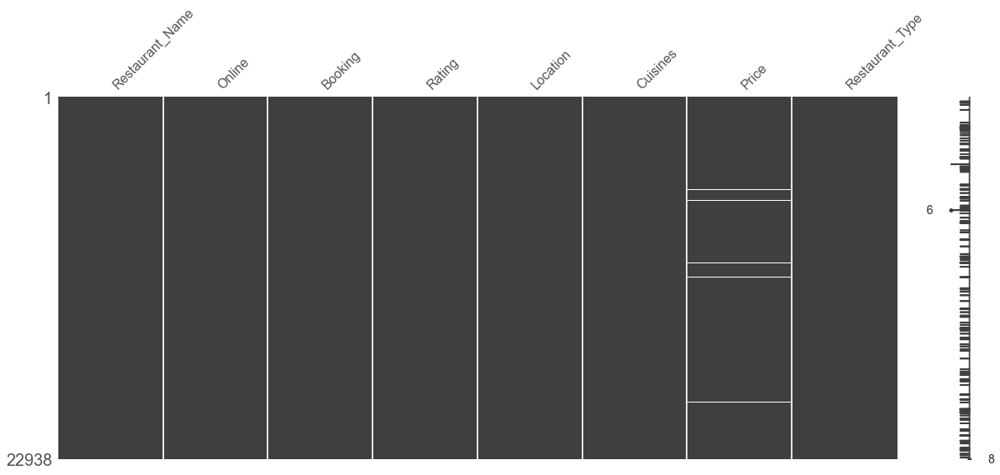

In [223]:
# To plot a graphic of missing values
missingno.matrix(df,figsize=(20,8))

- It is important to visualise missing values, because then you will know what are the major NaN values in your dataset.
- Here we can see that our 'Price' column has a few missing values. 

But it doesnt give us the full picture, so let's look more deeply into the columns to see how many missing values there are.

In [224]:
# Understanding more about the missing value columns

def missing_values_table(df):
    # number of missing values
    mis_val = df.isnull().sum()

    # % of missing values
    mis_val_percent = 100 * mis_val / len(df)

    # make table # axis '0' concat along index, '1' column
    mis_val_table = pd.concat([mis_val,mis_val_percent], axis= 1) 

    # rename columns
    mis_val_table_ren_columns = mis_val_table.rename(columns = {0: 'Missing Values', 1: '% of Total Values'})

    # sort by column
    mis_val_table_ren_columns = mis_val_table_ren_columns[mis_val_table_ren_columns.iloc[:,1]!= 0].sort_values(
        '% of Total Values', ascending= False).round(1) #Review
    print("Your selected dataset has " + str(df.shape[1]) + " columns and " + str(len(df)) + " observations.\n"
         "\n There are " + str(mis_val_table_ren_columns.shape[0]) + " columns that have missing values.")
    
    # return the dataframe with missing info
    return mis_val_table_ren_columns

missing_values_table(df)

Your selected dataset has 8 columns and 22938 observations.

 There are 2 columns that have missing values.


,Missing Values,% of Total Values
Price,132,0.6
Cuisines,7,0.0


### What Datatypes are there in the dataframe?

We usually consider features with a datatype of object as categorical features. And those with float or int could be numerical features.

However, sometimes the features that we consider as numerical might actually turn out to be categorical.

The next few steps will help us figure out how to process our data so our machine learning model can learn from it.
Ideally all the features will be encoded into a numerical value of some kind (maybe 0 or 1 / something else).

In [225]:
# Datatypes in the dataset
df.dtypes

Restaurant_Name     object
Online              object
Booking             object
Rating             float64
Location            object
Cuisines            object
Price              float64
Restaurant_Type     object
dtype: object

**Analysis from the above code**

1. Here we can see that most of our columns are of object type. 
2. We can also see that the Price column is having a float datatype. This is because of the presence of NULL values. 

### Exploring each of these features 
We will go through each of the columns and see which all we can use in our first models. Some of them needs more preprocessing than the others to get ready.

### UNIVARIATE ANALYSIS

In [226]:
df.head()

,Restaurant_Name,Online,Booking,Rating,Location,Cuisines,Price,Restaurant_Type
0,Fatso's,Yes,No,3.8,Brigade Road,"Cafe, American, Italian, Burger",650.0,Cafes
1,Biriyaniz,Yes,No,3.5,HSR,"Biryani, North Indian, Chinese, Andhra",400.0,Delivery
2,24@43 - The Oterra,No,Yes,4.1,Electronic City,"North Indian, Asian, Continental",3000.0,Dine-out
3,Upahara Bhavan,Yes,No,3.8,Bannerghatta Road,"South Indian, North Indian, Chinese",300.0,Delivery
4,Ross Kitchen,Yes,No,3.6,BTM,Chinese,400.0,Delivery


#### FEATURE 1: Online
Description: Whether Online ordering is there or not.

Yes    15003
No      7935
Name: Online, dtype: int64


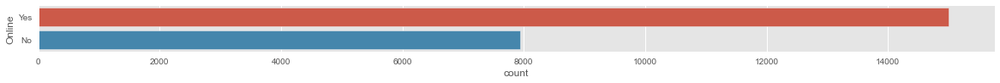

In [227]:
# How many restaurants have the option of Online services?
fig = plt.figure(figsize=(20,1))
sns.countplot(y='Online',data= df)
#sns.countplot(x='Online',data=df)             --> You can use this to get a vertical graph.
 
print(df['Online'].value_counts())             ##This will help us see the exact number along with the graph.

- Here we can see that most of the restaurants provide oline services. This is very prominant and also a necessary during this pandemic.

#### FEATURE 2: Booking
Description: Whether Booking a table is available or not.

No     19495
Yes     3443
Name: Booking, dtype: int64


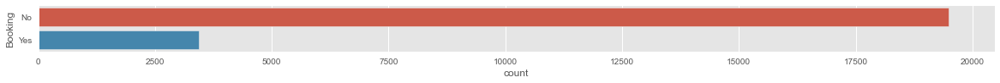

In [228]:
# How many restaurants have the option of Booking tables?
fig = plt.figure(figsize=(20,1))
sns.countplot(y='Booking',data= df)
#sns.countplot(x='Booking',data=df)             --> You can use this to get a vertical graph.
 
print(df['Booking'].value_counts())             ##This will help us see the exact number along with the graph.

- Here we can see that a majority of the restaurants don't have the option of booking. This can be mainly because of the fact that the pandemic is going on, also that most of the restaurants are not that fancy that they need any prior booking.

#### FEATURE 3: Rating
Description: The Ratings provided by each restaurant.

In [229]:
# Are there any missing values?
df['Rating'].isnull().sum()

0

<AxesSubplot:>

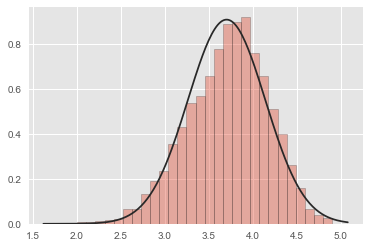

In [230]:
sns.distplot(x= df['Rating'], hist=True, kde= False, bins = 30, hist_kws={'edgecolor':'black'}, fit= norm)

- We can see here that most of the restaurants have a "Rating" in between 3.5 and 4.5. 
- In general, the rating distribution is not normal but in the highest score 3.9 has peak. 

We have to carefully see the condition of the highest rated restuarant.

#### FEATURE 4: Location
Description: The restaurant location.

In [231]:
# Are there any missing values?
df['Location'].isnull().any()

False

In [232]:
# Unique restaurants in Bangalore
df['Location'].nunique()

90

> We can see that there are a total of 90 restaurants. This is the same what we have seen in our initial step using the .describe() function.

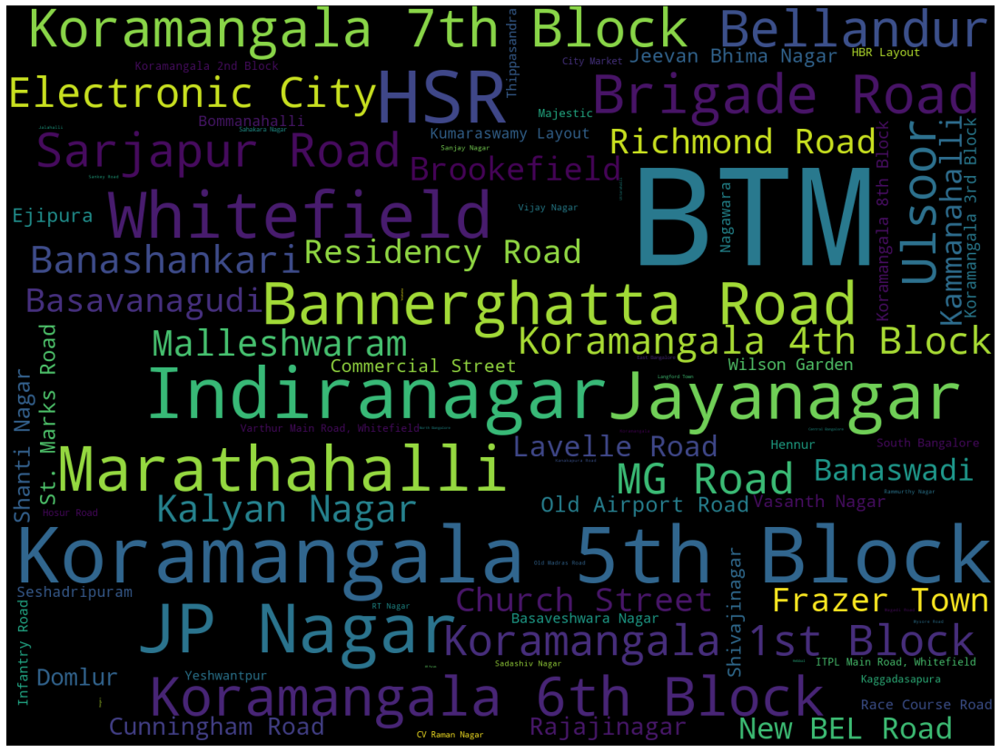

In [233]:
# To visualize the most frequent Locations in zomato app.
from subprocess import check_output
from wordcloud import WordCloud
wordcloud = (WordCloud(width=1440, height=1080, relative_scaling= 0.5).generate_from_frequencies(df['Location'].value_counts()))


fig = plt.figure(1,figsize=(25, 15))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

- Clearly BTM has the most number of restaurants in Bengaluru, followed by Koramangala 5th Block.

#### FEATURE 5: Cuisines
Description: The cooking traditions and practices of a restaurant.

In [234]:
# Total missing values in this column
df['Cuisines'].isnull().sum()

7

In [235]:
# Unique Cuisines in Bangalore
len({x.strip(' ') for lis in df['Cuisines'].dropna() for x in lis.split(',')})

104

- There are 104 different types of cuisines. Now let's find out which one is is the most common

In [236]:
cuisines = pd.Series([x.strip(' ') for lis in df['Cuisines'].dropna() for x in lis.split(',')], name = 'Bangalore Cuisines')
cuisines.value_counts(ascending = False).head()

North Indian    9525
Chinese         7103
Fast Food       3525
South Indian    3515
Continental     2860
Name: Bangalore Cuisines, dtype: int64

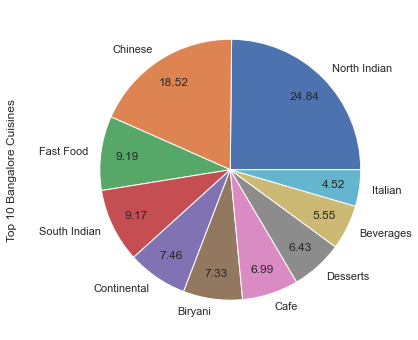

In [237]:
# Visualizing the top 10 most common cuisines in Bangalore.
sns.set()
plt.figure(figsize = (6,6))
cuisines.value_counts(ascending = False).head(10).plot(kind = 'pie', autopct = '%.2f', pctdistance = 0.8)
plt.ylabel('Top 10 Bangalore Cuisines', labelpad = 50)
plt.show()

- **Thus from the above plot we can see the top 10 Cuisines in Bangalore. It is visible that the "North Indian" cuisine is more prominant in zomato.**

> We could use the same methodology to deal with the missing values. However, the missing values only cover a tiny percentage of the total data, and the grouping would be larger since there are more than 100 different cuisines. 

It's safe to just fill the missing values with the most common cuisine which is North Indian.

In [238]:
# Filling the missing values.
df.loc[df['Cuisines'].isnull(), 'Cuisines'] = 'North Indian'
df['Cuisines'].isnull().sum()

0

#### FEATURE 6: Price
Description: The approximate Price of each Restaurant.

***This is the variable we want our ML model to predict based on the others.***

In [239]:
# Are there any missing values?
df['Price'].isnull().any()

True

- Inorder to overcome this issue we will replace all the NULL values with respect to their <u>Mean Price in the respective Location</u>.

In [240]:
# Locations where the Price is unknown.
df[df['Price'].isnull()]['Location'].unique()

array(['MG Road', 'Banaswadi', 'HSR', 'Koramangala 5th Block',
       'Kammanahalli', 'Koramangala 6th Block', 'Marathahalli',
       'Sarjapur Road', 'BTM', 'Varthur Main Road, Whitefield',
       'Residency Road', 'Indiranagar', 'Richmond Road', 'Lavelle Road',
       'Whitefield', 'Koramangala 7th Block', 'City Market',
       'Koramangala 8th Block', 'Bannerghatta Road', 'Old Airport Road',
       'Domlur', 'Frazer Town', 'RT Nagar', 'Jayanagar',
       'Basaveshwara Nagar', 'Hennur', 'Vijay Nagar', 'New BEL Road',
       'Kalyan Nagar', 'Malleshwaram', 'Yelahanka', 'Ejipura'],
      dtype=object)

In [241]:
# Total number of Locations where the Price is unknown.
df[df['Price'].isnull()]['Location'].nunique()

32

- We can see that out of the 90 Restaurants in Bangalore, 32 Restaurants have missing Price value in different locations.

In [242]:
df.index[:20]

Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19,
            20],
           dtype='int64')

In [243]:
df.insert(0, '', range(0, 0 + len(df)))
df.head()

,,Restaurant_Name,Online,Booking,Rating,Location,Cuisines,Price,Restaurant_Type
0,0,Fatso's,Yes,No,3.8,Brigade Road,"Cafe, American, Italian, Burger",650.0,Cafes
1,1,Biriyaniz,Yes,No,3.5,HSR,"Biryani, North Indian, Chinese, Andhra",400.0,Delivery
2,2,24@43 - The Oterra,No,Yes,4.1,Electronic City,"North Indian, Asian, Continental",3000.0,Dine-out
3,3,Upahara Bhavan,Yes,No,3.8,Bannerghatta Road,"South Indian, North Indian, Chinese",300.0,Delivery
4,4,Ross Kitchen,Yes,No,3.6,BTM,Chinese,400.0,Delivery


In [244]:
df.set_index('', inplace= True)
df.head()

,Restaurant_Name,Online,Booking,Rating,Location,Cuisines,Price,Restaurant_Type
,,,,,,,,
0,Fatso's,Yes,No,3.8,Brigade Road,"Cafe, American, Italian, Burger",650.0,Cafes
1,Biriyaniz,Yes,No,3.5,HSR,"Biryani, North Indian, Chinese, Andhra",400.0,Delivery
2,24@43 - The Oterra,No,Yes,4.1,Electronic City,"North Indian, Asian, Continental",3000.0,Dine-out
3,Upahara Bhavan,Yes,No,3.8,Bannerghatta Road,"South Indian, North Indian, Chinese",300.0,Delivery
4,Ross Kitchen,Yes,No,3.6,BTM,Chinese,400.0,Delivery


In [245]:
Places = df[df['Price'].isnull()]['Location'].unique()
for i in Places:
    print("Mean Price is : ", np.mean(df[df['Location'] == i]['Price']), f'for {i}')

Mean Price is :  1270.6496519721577 for MG Road
Mean Price is :  428.0 for Banaswadi
Mean Price is :  505.914362176628 for HSR
Mean Price is :  683.2683307332293 for Koramangala 5th Block
Mean Price is :  492.77777777777777 for Kammanahalli
Mean Price is :  617.8391959798995 for Koramangala 6th Block
Mean Price is :  565.0564617314931 for Marathahalli
Mean Price is :  621.3815789473684 for Sarjapur Road
Mean Price is :  422.0152091254753 for BTM
Mean Price is :  344.44444444444446 for Varthur Main Road, Whitefield
Mean Price is :  1040.3125 for Residency Road
Mean Price is :  682.8669950738916 for Indiranagar
Mean Price is :  884.9415204678363 for Richmond Road
Mean Price is :  1307.1984435797665 for Lavelle Road
Mean Price is :  681.7591499409681 for Whitefield
Mean Price is :  624.5283018867924 for Koramangala 7th Block
Mean Price is :  319.925 for City Market
Mean Price is :  386.283185840708 for Koramangala 8th Block
Mean Price is :  469.2640692640693 for Bannerghatta Road
Mean Pri

In [246]:
# Initially filling with 0.
df['Price'] = df['Price'].fillna(0)

In [247]:
# This loop assign these values to zero values according to the gender.
for i in range(0,22938):
    if(df['Price'][i] == 0):
        if(df['Location'][i] == 'MG Road'):
          df['Price'][i] = 1300
        elif(df['Location'][i] == 'Banaswadi'):
          df['Price'][i] = 450
        elif(df['Location'][i] == 'HSR'):
          df['Price'][i] = 500
        elif(df['Location'][i] == 'Koramangala 5th Block'):
          df['Price'][i] = 700
        elif(df['Location'][i] == 'Kammanahalli'):
          df['Price'][i] = 500
        elif(df['Location'][i] == 'Koramangala 6th Block'):
          df['Price'][i] = 600
        elif(df['Location'][i] == 'Marathahalli'):
          df['Price'][i] = 600
        elif(df['Location'][i] == 'Sarjapur Road'):
          df['Price'][i] = 600
        elif(df['Location'][i] == 'BTM'):
          df['Price'][i] = 400
        elif(df['Location'][i] == 'Varthur Main Road, Whitefield'):
          df['Price'][i] = 350
        elif(df['Location'][i] == 'Residency Road'):
          df['Price'][i] = 1050
        elif(df['Location'][i] == 'Indiranagar'):
          df['Price'][i] = 700
        elif(df['Location'][i] == 'Richmond Road'):
          df['Price'][i] = 900
        elif(df['Location'][i] == 'Lavelle Road'):
          df['Price'][i] = 1300
        elif(df['Location'][i] == 'Whitefield'):
          df['Price'][i] = 700
        elif(df['Location'][i] == 'Koramangala 7th Block'):
          df['Price'][i] = 600
        elif(df['Location'][i] == 'City Market'):
          df['Price'][i] = 300
        elif(df['Location'][i] == 'Koramangala 8th Block'):
          df['Price'][i] = 400
        elif(df['Location'][i] == 'Bannerghatta Road'):
          df['Price'][i] = 500
        elif(df['Location'][i] == 'Old Airport Road'):
          df['Price'][i] = 750
        elif(df['Location'][i] == 'Domlur'):
          df['Price'][i] = 650
        elif(df['Location'][i] == 'Frazer Town'):
          df['Price'][i] = 500
        elif(df['Location'][i] == 'RT Nagar'):
          df['Price'][i] = 400
        elif(df['Location'][i] == 'Jayanagar'):
          df['Price'][i] = 500
        elif(df['Location'][i] == 'Basaveshwara Nagar'):
          df['Price'][i] = 500
        elif(df['Location'][i] == 'Hennur'):
          df['Price'][i] = 400
        elif(df['Location'][i] == 'Vijay Nagar'):
          df['Price'][i] = 400
        elif(df['Location'][i] == 'New BEL Road'):
          df['Price'][i] = 500
        elif(df['Location'][i] == 'Kalyan Nagar'):
          df['Price'][i] = 600
        elif(df['Location'][i] == 'Malleshwaram'):
          df['Price'][i] = 600
        elif(df['Location'][i] == 'Yelahanka'):
          df['Price'][i] = 300
        elif(df['Location'][i] == 'Ejipura'):
          df['Price'][i] = 350
        else:
          df['Price'][i] = df['Price'][i]
    else:
      continue      

In [248]:
# Are there any missing values?
df['Price'].isnull().any()

False

<AxesSubplot:ylabel='Density'>

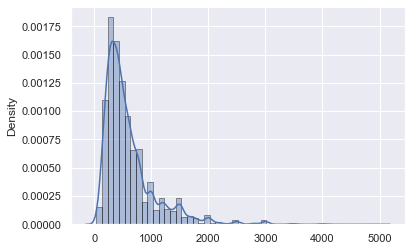

In [49]:
sns.distplot(x= df['Price'], hist= True, kde= True, hist_kws= {'edgecolor':'black'})

- We can see here that our target variable is infact skewed (right-skewed). 

Skewness refers to a distortion or asymmetry that deviates from the symmetrical bell curve, or normal distribution, in a set of data. 

#### FEATURE 7: Restaurant Type
Description: The different types of Restaurants.

In [50]:
# Are there any missing values?
df['Restaurant_Type'].isnull().any()

False

In [51]:
# Unique Restaurant Types.
df['Restaurant_Type'].unique()

array(['Cafes', 'Delivery', 'Dine-out', 'Desserts', 'Buffet',
       'Pubs and bars', 'Drinks & nightlife'], dtype=object)

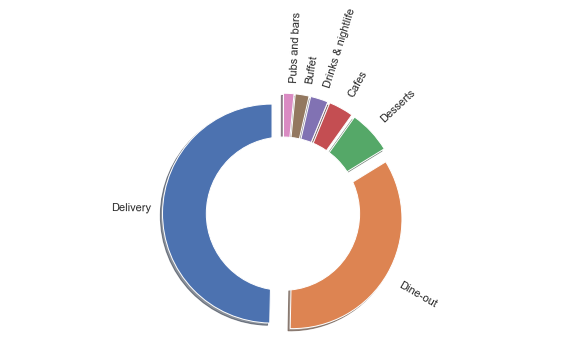

In [52]:
# Pie chart
labels = df['Restaurant_Type'].value_counts().index
sizes = df['Restaurant_Type'].value_counts().values
# only "explode" the 2nd slice (i.e. 'Hogs')
explode = (0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1)
fig1, ax1 = plt.subplots(figsize = (8, 5))

ax1.pie(sizes, labels = labels,
        shadow = True, startangle = 90, explode = explode, rotatelabels = True)
centre_circle = plt.Circle((0, 0), 0.70,fc = 'white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

# Equal aspect ratio ensures that pie is drawn as a circle
ax1.axis('equal')  
plt.tight_layout()
plt.show()

- Majority of the restaurants Delivers the food to the homes, very less proportion are pubs and bars or Drinks & nightlife.

### BIVARIATE ANALYSIS

#### OBJECTIVES:

1. Most famous Restaurant Chains.

2. Impact of Online order & table Booking on Rating.

3. Highly rated Restaurants and Locations in Bangalore.

4. Average Price and Rating of different Restaurant types.

5. Relationship between Rating, Price and availability of Online order.

6. Relationship between Price and Rating.

#### 1. Most famous Restaurant Chains (In top 5 Locations).

Text(0.5, 0, 'Number of outlets')

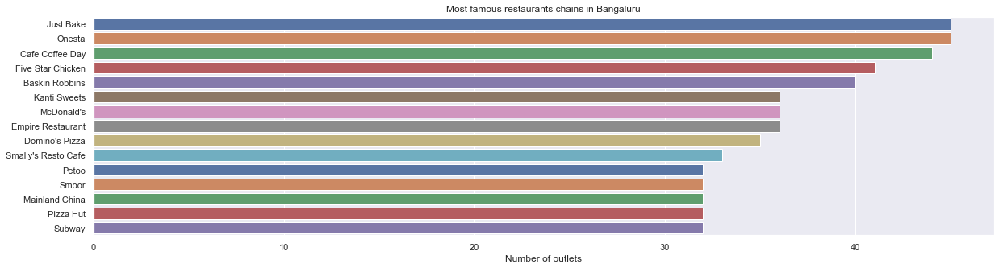

In [53]:
# Most famous chains all over Bangalore.
plt.figure(figsize=(20,5))

chains=df['Restaurant_Name'].value_counts()[:15]
sns.barplot(x= chains, y= chains.index, palette= 'deep')

plt.title("Most famous restaurants chains in Bangaluru")
plt.xlabel("Number of outlets")

In [54]:
# Displaying the Locations which has the highest number of Restaurants.
df['Location'].value_counts().nlargest(5)

BTM                      2118
Koramangala 5th Block    1294
HSR                      1129
Indiranagar              1036
JP Nagar                  953
Name: Location, dtype: int64

In [55]:
# To see the count of each Restaurants is different Locations.
table = pd.pivot_table(df, index=['Location', 'Restaurant_Name'], values= 'Restaurant_Type', aggfunc= 'count')

In [56]:
table.query('Location == ["BTM"]').nlargest(3,'Restaurant_Type')

Restaurant_Type
Location Restaurant_Name                           
BTM      Cafe 221B                               15
         New Surya Sweets & Snacks               12
         Borah's Kitchen                         11

In [57]:
table.query('Location == ["Koramangala 5th Block"]').nlargest(3,'Restaurant_Type')

Restaurant_Type
Location              Restaurant_Name                  
Koramangala 5th Block Buff Buffet Buff               15
                      Bonsouth                       14
                      Crawl Street                   12

In [58]:
table.query('Location == ["HSR"]').nlargest(3,'Restaurant_Type')

Restaurant_Type
Location Restaurant_Name                 
HSR      Navya Foods                   10
         Azimmo Treat                   8
         Foodiesthan                    8

In [59]:
table.query('Location == ["Indiranagar"]').nlargest(3,'Restaurant_Type')

Restaurant_Type
Location    Restaurant_Name                      
Indiranagar Kulfi Point                         8
            Ciclo Cafe                          7
            Donne Biriyani House                7

In [60]:
table.query('Location == ["JP Nagar"]').nlargest(3,'Restaurant_Type')

Restaurant_Type
Location Restaurant_Name                 
JP Nagar Cafe Potpourri                 8
         Crafted Plate                  8
         D View Cafe                    8

#### 2. Impact of Online order & table Booking on Rating.

In [61]:
# To see the average Rating when Online ordering is available.
table_online = pd.pivot_table(df, index=['Online'], values= 'Rating', aggfunc= 'mean')
table_online

,Rating
Online,
No,3.659534
Yes,3.724182


- **Checking whether the Online ordering affects the Rating of the Restaurant.**

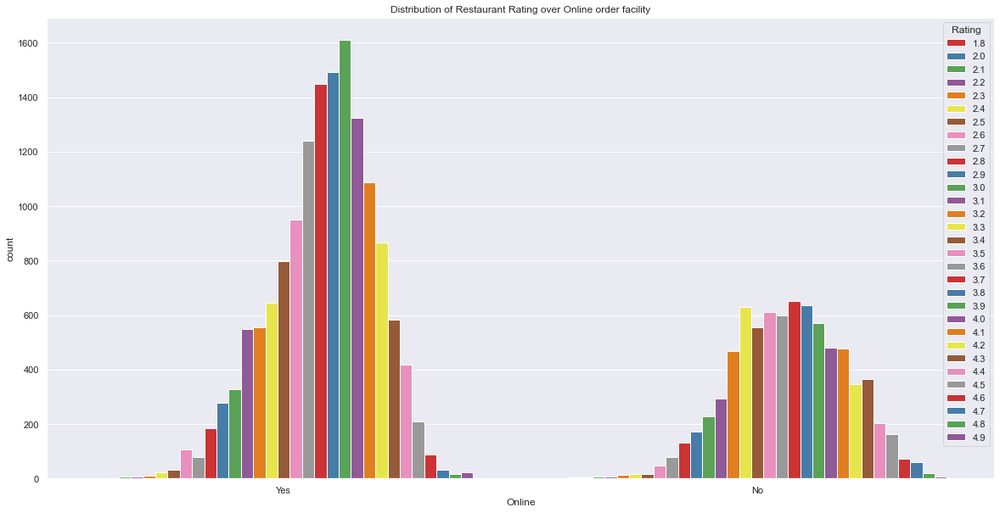

In [62]:
plt.figure(figsize=(20,10))
sns.countplot(x = df['Online'], hue = df['Rating'], palette= 'Set1')
plt.title("Distribution of Restaurant Rating over Online order facility")
plt.show()

> We can clearly see that the Restaurants which are having Online ordering facility tends to have higher ratings as compared to the restaurants which dont have  Online ordering facility available with them.

In [63]:
# To see the average Rating when table Booking is available.
table_book = pd.pivot_table(df, index=['Booking'], values= 'Rating', aggfunc= 'mean')
table_book

,Rating
Booking,
No,3.623139
Yes,4.147313


- **Checking whether the table Booking affects the Rating of the Restaurant.**

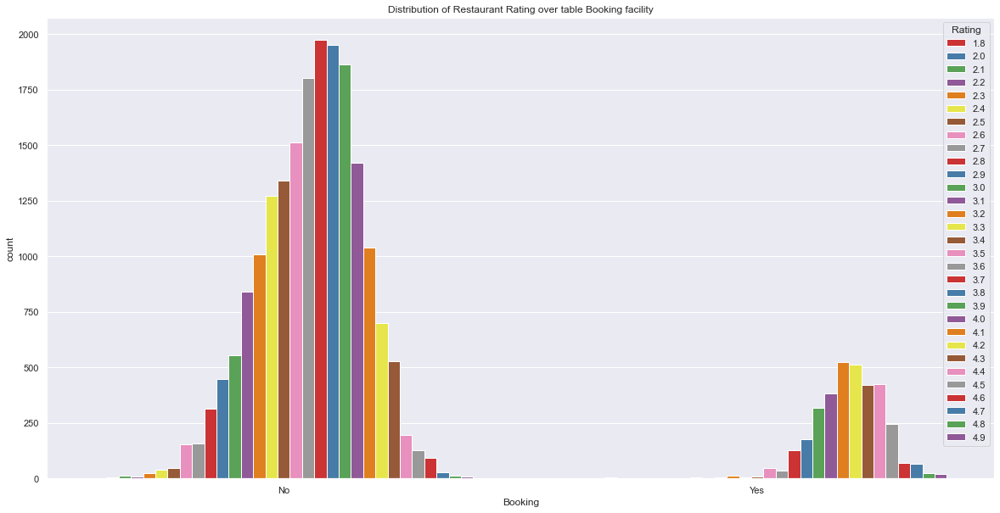

In [64]:
plt.figure(figsize=(20,10))
sns.countplot(x = df['Booking'], hue = df['Rating'], palette= 'Set1')
plt.title("Distribution of Restaurant Rating over table Booking facility")
plt.show()

**Here we can see that in the case when Online ordering and table Booking was available the average Rating of the Restaurants is comparitively higher.**

#### 3. Highly rated Restaurants and Locations in Bangalore.

By the term "Highly Rated" we will be keeping the Restaurant Ratings above 3.9 as this was the highest peak value for us in our initial Analysis.

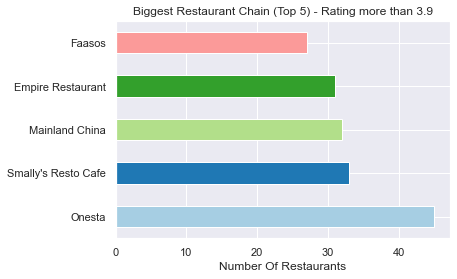

In [65]:
df[df['Rating'] >= 3.9]['Restaurant_Name'].value_counts().nlargest(5).plot(kind = 'barh', color = sns.color_palette("Paired"))
plt.xlabel("Number Of Restaurants")
plt.title("Biggest Restaurant Chain (Top 5) - Rating more than 3.9")
plt.show()

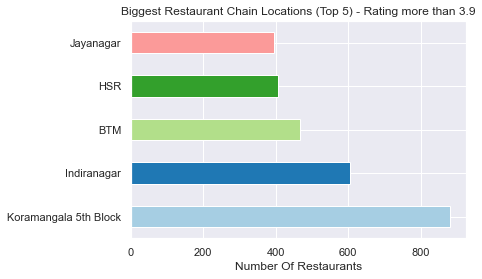

In [66]:
df[df['Rating'] >= 3.9]['Location'].value_counts().nlargest(5).plot(kind = 'barh', color = sns.color_palette("Paired"))
plt.xlabel("Number Of Restaurants")
plt.title("Biggest Restaurant Chain Locations (Top 5) - Rating more than 3.9")
plt.show()

- From the previous two Analysis we can conclude that if you visit Banglore next time and if you want to check out a good restaurant over a weekend dont forget to try the food at Onesta, Smally's and Mainland China. Also do visit Koramangala as they have a lot of Restaurants that can provide mouthwatering flavours.

#### 4. Average Price and Rating of different Restaurant types.

In [67]:
# To see the average Rating & Price when table Booking is available for different Restaurant types.
table2 = pd.pivot_table(df, index=['Restaurant_Type','Booking'], values= ['Price','Rating'], aggfunc= 'mean')
table2.query('Booking == ["Yes"]')

,,Price,Rating
Restaurant_Type,Booking,,
Buffet,Yes,1399.140893,4.184192
Cafes,Yes,895.302013,4.149664
Delivery,Yes,1081.267874,4.100095
Desserts,Yes,1088.732394,4.195775
Dine-out,Yes,1359.702063,4.150115
Drinks & nightlife,Yes,1535.399449,4.194490
Pubs and bars,Yes,1456.161137,4.214692


- We can see that when table booking is available the Average Rating is above 4 and Price is in the range of 1000 rupees.

#### 5. Relationship between Rating, Price and availability of Online order.

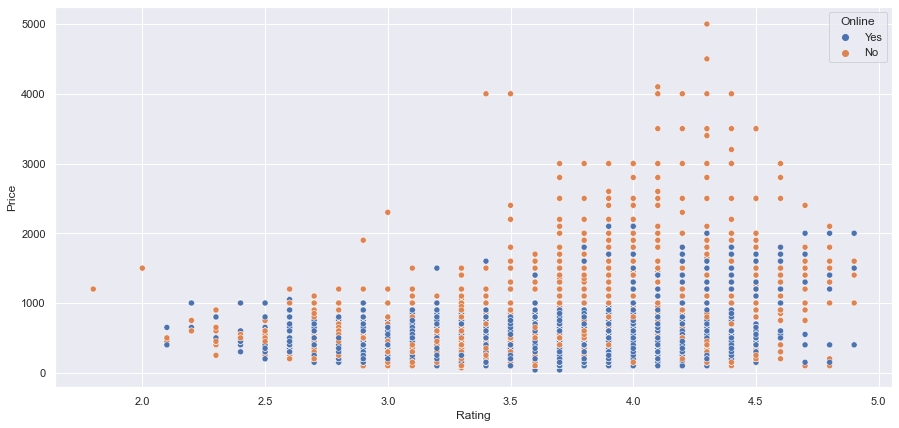

In [68]:
plt.figure(figsize=(15,7))
sns.scatterplot(x="Rating", y='Price', hue='Online', data=df)
plt.show()

- As it is visible that there is not much noticeable correlation between the rating and average cost wrt availability of online order .

#### 6. Relationship between Price and Rating.

Joint plot allows us to compare two different variables and see if there is any relationship between these two variables. By using joint plot we can do both univariate and bivariate analysis by plotting the scatter plot (bivariate) and distribution plot (univariate) of two different variables in a single plotting grid

<Figure size 1008x720 with 0 Axes>

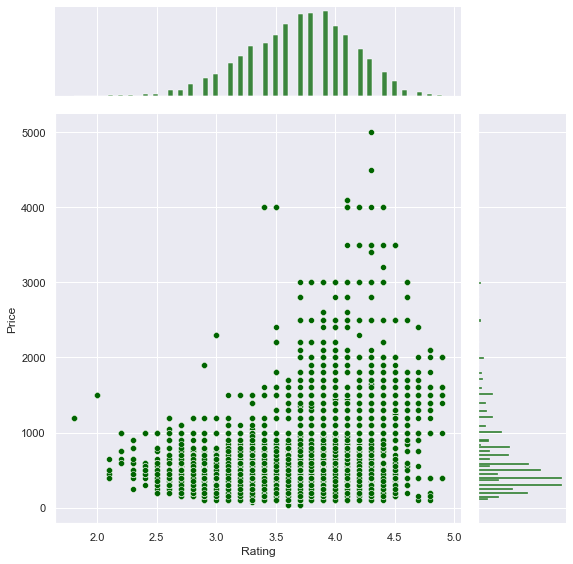

In [69]:
plt.figure(figsize=(14,10))
sns.set_style("darkgrid")
sns.jointplot(x = 'Rating', y = 'Price', data=df, color = 'darkgreen',height = 8, ratio = 4)

- From the scatter plot we can see that the restaurants with higher number of rating have higher price.

## 4. Data Preprocessing

### 4.1 Data Transformation

<AxesSubplot:ylabel='Density'>

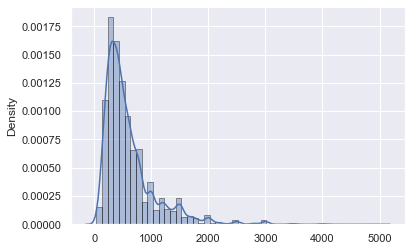

In [70]:
sns.distplot(x= df['Price'], hist= True, kde= True, hist_kws= {'edgecolor':'black'})

- In the previous section, we addressed the problem of skewness in our target variable i.e. Price. Skewed data is cumbersome and it's often desirable to transform skewed data.
 
- To fix the problem of skewness, we perform log transformation in this section.**

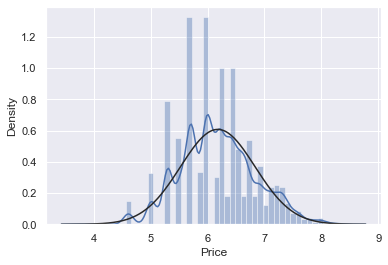

<Figure size 432x288 with 0 Axes>

In [71]:
df['Price'] = np.log(df['Price'])
sns.distplot(df['Price'], fit=norm)
fig = plt.figure()

- We can observe the difference in the distribution of the data before transforming and after transforming. Now, the data has a perfect bell shape curve. 

### 4.2 Feature Encoding

#### Label Encoding & One-Hot Encoding

In label encoding, we replace the categorical value with a numeric value between 0 and the number of classes minus 1. 
Though label encoding is straight but it has the disadvantage that the numeric values can be misinterpreted by algorithms as having some sort of hierarchy/order in them. 

This ordering issue is addressed in another common alternative approach called ‘One-Hot Encoding’. In this strategy, each category value is converted into a new column and assigned a 1 or 0 (notation for true/false)value to the column. 

- Nominal Data -> Doesn't have any order -> One-Hot Encoding

- Ordinal Data -> Follows an order -> Label Encoding

In [72]:
# Lets have a look at how many variables each label has.
for col in df.columns:
    print(col, ": ", len(df[col].unique()), "labels")

Restaurant_Name :  5911 labels
Online :  2 labels
Booking :  2 labels
Rating :  31 labels
Location :  90 labels
Cuisines :  2208 labels
Price :  58 labels
Restaurant_Type :  7 labels


- Here we can see that except for "Restaurant_Name", "Online" & "Booking" all other columns will follow some order with respect the target variable (Price). So we will be doing **Label Encoding** to all the columns and will be dealing with the "Restaurant_Name" using One-Hot Encoding.



#### Let's seperate the data

In [73]:
# Split the dataframe into features (predictive variables) and labels (target variable).

X = df.drop(columns= ['Price'])     # --> Features
y = df['Price']                     # --> Label

In [74]:
X.head()

,Restaurant_Name,Online,Booking,Rating,Location,Cuisines,Restaurant_Type
,,,,,,,
0,Fatso's,Yes,No,3.8,Brigade Road,"Cafe, American, Italian, Burger",Cafes
1,Biriyaniz,Yes,No,3.5,HSR,"Biryani, North Indian, Chinese, Andhra",Delivery
2,24@43 - The Oterra,No,Yes,4.1,Electronic City,"North Indian, Asian, Continental",Dine-out
3,Upahara Bhavan,Yes,No,3.8,Bannerghatta Road,"South Indian, North Indian, Chinese",Delivery
4,Ross Kitchen,Yes,No,3.6,BTM,Chinese,Delivery


- We will now be removing the 'Restaurant_Name' & 'Rating' column as the remaining columns we will be Label Encoding.

In [75]:
Later = X[['Restaurant_Name', 'Rating']]
Later.head()

,Restaurant_Name,Rating
,,
0,Fatso's,3.8
1,Biriyaniz,3.5
2,24@43 - The Oterra,4.1
3,Upahara Bhavan,3.8
4,Ross Kitchen,3.6


In [76]:
X.drop(columns= ['Restaurant_Name', 'Rating'], inplace= True)
X.head()

,Online,Booking,Location,Cuisines,Restaurant_Type
,,,,,
0,Yes,No,Brigade Road,"Cafe, American, Italian, Burger",Cafes
1,Yes,No,HSR,"Biryani, North Indian, Chinese, Andhra",Delivery
2,No,Yes,Electronic City,"North Indian, Asian, Continental",Dine-out
3,Yes,No,Bannerghatta Road,"South Indian, North Indian, Chinese",Delivery
4,Yes,No,BTM,Chinese,Delivery


In [77]:
# Label Encoding using LabelEncoder()                         
X = X.apply(LabelEncoder().fit_transform)
X.head(10)

,Online,Booking,Location,Cuisines,Restaurant_Type
,,,,,
0,1,0,8,449,1
1,1,0,22,371,2
2,0,1,19,1501,4
3,1,0,3,2080,2
4,1,0,0,654,2
5,0,0,35,2,3
6,1,0,35,1545,4
7,1,0,77,1046,2
8,0,1,44,15,4


In [78]:
# Combining the columns which we had set aside with the Label Encoded X.
X['Rating'] = Later['Rating']
X['Restaurant_Name'] = Later['Restaurant_Name']
X.head()

,Online,Booking,Location,Cuisines,Restaurant_Type,Rating,Restaurant_Name
,,,,,,,
0,1,0,8,449,1,3.8,Fatso's
1,1,0,22,371,2,3.5,Biriyaniz
2,0,1,19,1501,4,4.1,24@43 - The Oterra
3,1,0,3,2080,2,3.8,Upahara Bhavan
4,1,0,0,654,2,3.6,Ross Kitchen


- Before we can go any further we have already seen discussed that with the "Restaurant_Name" column we will be performing One-Hot Encoding.

- But if we had directly performed One-Hot Encoding, from just 1 categorical variable we could end up with a huge number of variables. This may give rise to ***Curse of Dimensionality***. 

**Therefore, we will limit one hot encoding to 10 most frequent variables of the "Restaurant_Name" column.**

In [79]:
# Lets find the top 10 most frequent categories for Restaurant Names.
X.Restaurant_Name.value_counts().sort_values(ascending=False).head(10)

Just Bake              45
Onesta                 45
Cafe Coffee Day        44
Five Star Chicken      41
Baskin Robbins         40
Kanti Sweets           36
McDonald's             36
Empire Restaurant      36
Domino's Pizza         35
Smally's Resto Cafe    33
Name: Restaurant_Name, dtype: int64

In [80]:
# Lets make a list with the most frequent categories of the variable
top10_Restaurant = [x for x in X.Restaurant_Name.value_counts().sort_values(ascending=False).head(10).index]
top10_Restaurant

['Just Bake',
 'Onesta',
 'Cafe Coffee Day',
 'Five Star Chicken',
 'Baskin Robbins',
 'Kanti Sweets',
 "McDonald's",
 'Empire Restaurant',
 "Domino's Pizza",
 "Smally's Resto Cafe"]

In [81]:
# This function will help us in applying One-Hot Encoding (OHE) to the required columns.
def OHE(df, variable, top_x_labels):
    for label in top_x_labels:
        df[variable+'_'+label] = np.where(df[variable]==label, 1, 0)

### Here the parameter for OHE are:- 
# df -> The Dataset.
# variable -> Column which we need to apply One-Hot Encoding.
# top_x_labels -> Top 10 values in that specific column which we had already extracted.


OHE(X, 'Restaurant_Name', top10_Restaurant)

In [82]:
X.drop(columns= ['Restaurant_Name'],inplace= True)
X.head()

,Online,Booking,Location,Cuisines,Restaurant_Type,Rating,Restaurant_Name_Just Bake,Restaurant_Name_Onesta,Restaurant_Name_Cafe Coffee Day,Restaurant_Name_Five Star Chicken,Restaurant_Name_Baskin Robbins,Restaurant_Name_Kanti Sweets,Restaurant_Name_McDonald's,Restaurant_Name_Empire Restaurant,Restaurant_Name_Domino's Pizza,Restaurant_Name_Smally's Resto Cafe
,,,,,,,,,,,,,,,,
0,1,0,8,449,1,3.8,0,0,0,0,0,0,0,0,0,0
1,1,0,22,371,2,3.5,0,0,0,0,0,0,0,0,0,0
2,0,1,19,1501,4,4.1,0,0,0,0,0,0,0,0,0,0
3,1,0,3,2080,2,3.8,0,0,0,0,0,0,0,0,0,0
4,1,0,0,654,2,3.6,0,0,0,0,0,0,0,0,0,0


In [83]:
# Dimension of the X dataset after Feature Encoding.
X.shape

(22938, 16)

In [84]:
# Dimension of the y dataset after Feature Encoding.
y.shape

(22938,)

## 5. Initial Model Analysis Using Multiple Linear Regression

Multiple regression, is a statistical technique that uses several explanatory variables to predict the outcome of a response variable. Multiple regression is an extension of linear (OLS) regression that uses just one explanatory variable.

The equation of the model is given by:
 
                yi = β0 + β1xi1 + β2xi2 +...+ βpxip + ϵ 	
                
where, for i = n observations:

yi  = dependent variable

xi = explanatory variables

β0 = y-intercept (constant term)

βp = slope coefficients for each explanatory variable

ϵ = the model’s error term (also known as the residuals)
                
Assumptions of MLR

- The error terms must follow normal distribution.

- The error terms must have a population mean of zero.

- The error terms must have a constant variance.

- The error terms must be uncorrelated.

- There should be zero covaraince between error terms and explanatory variables.

- There is no correlation between independent variables.

In [85]:
# Train Test Split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state= 100)

- #### Analysis on Train Dataset

In [86]:
from sklearn.linear_model import LinearRegression
model=LinearRegression()

model.fit(X_train,y_train)      # Fitting the Training Model.

LinearRegression()

In [87]:
from statsmodels.api import OLS
OLS(y_train,X_train).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                  Price   R-squared (uncentered):                   0.986
Model:                            OLS   Adj. R-squared (uncentered):              0.986
Method:                 Least Squares   F-statistic:                          8.119e+04
Date:                Tue, 27 Apr 2021   Prob (F-statistic):                        0.00
Time:                        19:43:26   Log-Likelihood:                         -20338.
No. Observations:               18350   AIC:                                  4.071e+04
Df Residuals:                   18334   BIC:                                  4.083e+04
Df Model:                          16                                                  
Covariance Type:            nonrobust                                                  
=======================================================================================================
                                          coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
Online                                  0.0392      0.012      3.332      0.001       0.016       0.062
Booking                                 0.2791      0.016     17.680      0.000       0.248       0.310
Location                                0.0035      0.000     16.405      0.000       0.003       0.004
Cuisines                                0.0001   8.43e-06     14.026      0.000       0.000       0.000
Restaurant_Type                         0.1530      0.005     32.803      0.000       0.144       0.162
Rating                                  1.4514      0.005    265.035      0.000       1.441       1.462
Restaurant_Name_Just Bake               0.4172      0.124      3.354      0.001       0.173       0.661
Restaurant_Name_Onesta                 -0.9728      0.122     -7.988      0.000      -1.212      -0.734
Restaurant_Name_Cafe Coffee Day         1.4842      0.128     11.609      0.000       1.234       1.735
Restaurant_Name_Five Star Chicken      -0.2817      0.139     -2.030      0.042      -0.554      -0.010
Restaurant_Name_Baskin Robbins         -0.4063      0.134     -3.032      0.002      -0.669      -0.144
Restaurant_Name_Kanti Sweets           -0.3619      0.141     -2.560      0.010      -0.639      -0.085
Restaurant_Name_McDonald's              0.3472      0.136      2.544      0.011       0.080       0.615
Restaurant_Name_Empire Restaurant      -0.0096      0.128     -0.075      0.940      -0.260       0.241
Restaurant_Name_Domino's Pizza          0.3990      0.147      2.714      0.007       0.111       0.687
Restaurant_Name_Smally's Resto Cafe    -0.3878      0.139     -2.791      0.005      -0.660      -0.115
==============================================================================
Omnibus:                      530.301   Durbin-Watson:                   2.005
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              793.942
Skew:                           0.296   Prob(JB):                    3.96e-173
Kurtosis:                       3.829   Cond. No.                     3.52e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 3.52e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

- #### Analysis of the OLS summary using training dataset

**Ordinary Least Squares**

Ordinary least squares (OLS) is a type of linear least squares method for estimating the unknown parameters in a linear regression model.

**R-Squared**

R-Squared tells us the explained variation or the ratio of the explained sum of squares to the total sum of squares.

The R-squared is 0.98 which implies 98% of the variation in response variable is explained by the predictor variables and remaining 2% is due to error.

**Adjusted R-Squared**

Adjusted coefficient of multiple determination measures the proportion of variation in the dependent variable y which is explained by the variation in two or more independent variables. The coefficient of determination R-Squared does not take into account loss of degree of freedom from the inclusion of explanatory variables used in the model to correct this we use Adjusted R-Squared. This statistic takes explicit account of the number of explanatory variables used in the function. It is useful for comparing the fit of specifications that differs in inclusion or exclusion of explanatory variables.

The Adjusted R-Squared value is also 0.98 .i.e. 98%. Since the number of observations are relatively large compared to the number of regressors, the R-Squared and Adjusted R-Squared are equal.

**F-Statistic**

To check the adequacy of the fitted model, we use F-statistic.

H0: Overall model is not significant. 

H1: Atleast one of the regressor is significant

When the number of data points is large, an F-statistic that is only a little bit larger than 1 is already sufficient to reject the null hypothesis. The F-statistic value is 81190 which is much larger than 1. Hence, we reject the null hypothesis. Therefore, atleast one of the regressor is significant.

**AIC**

This criteria tries to balance the conflicting demands of accuracy and simplicity. The AIC value is 40710.

**BIC**

This is a modification in AIC. The BIC value is 40830.

**Coefficients**

The regression coefficients are estimates of the unknown population parameters and describe the relationship between a predictor variable and the response. The sign of each coefficient indicates the direction of the relationship between a predictor variable and the response variable.

- A positive sign indicates that as the predictor variable increases, the response variable also increases. The variables Online, Booking, Location, Cuisines, Restaurant_Type,	Rating,	Restaurant_Name_Just Bake, Restaurant_Name_Cafe Coffee Day, Restaurant_Name_McDonald's, and Restaurant_Name_Domino's Pizza contributes positively to Price.

- A negative sign indicates that as the predictor variable increases, the response variable decreases. The variables Restaurant_Name_Onesta, Restaurant_Name_Five Star Chicken, Restaurant_Name_Baskin Robbins,	Restaurant_Name_Kanti Sweets, Restaurant_Name_Empire Restaurant, and Restaurant_Name_Smally's Resto Cafe contributes negatively to Price.

**Standard Error**

The coefficient Standard Error measures the average amount that the coefficient estimates vary from the actual average value of our response variable. The standard error closer to zero is an indication of good fit.

From the OLS summary we can observe that most of the coefficients have std error close to 0.

**t-statistic**

In testing of overall significance if null hypothesis is rejected, then atleast one of the regressor has significant effect on the response variable. To search which regressor has effect on the response variable, we use the t-statistic.

H0: There is no linear relationship between the dependent and independent variable.

H1: There exists a linear relationship between the dependent and independent variable.

Since the p > 0.05 for the variable Restaurant_Name_Empire Restaurant, there is no evidence to reject the null hypothesis. Hence, there is no linear relationship between Restaurant_Name_Empire Restaurant and Price. For all the other variables we have p < 0.05, hence, we reject the null hypothesis. Therefore, all the other variables have linear relationship with price.

**Normality Test**

**Omnibus & Prob(Omnibus)**

It is a test of the skewness and kurtosis of the residuals. The Omnibus value is 530.301 which is much greater than zero. This indicates deviation from the normality assumption.

The Prob (Omnibus) performs a statistical test indicating the probability that the residuals are normally distributed. The Prob (Omnibus) value is 0 which is less than 1, hence we can conclude that there is a breach in the normality assumption.

**Skew**

It is a measure of data symmetry. The skewness value is 0.296 which is greater than 0 and hence, indicates the presence of skewness and deviation from  normality.

**Kurtosis**

It is a measure of "peakiness", or curvature of the data. Higher peaks lead to greater Kurtosis. Greater Kurtosis can be interpreted as a tighter clustering of residuals around zero. The value of kurtosis is 3.829 which very low.

**Jarque-Bera(JB) & Prob(JB)**

Like the Omnibus test in that it tests both skew and kurtosis. The Jarque-Bera value is 530.301 which is much greater than 0. This indicates deviation from the normality assumption. The Prob(JB) value is approxmately 0 which is less than 1, hence we can conclude that there is a breach in the normality assumption.

**Durbin-Watson**

The test developed by Durbin & Watson is widely used to detect the presence of autocorrelation. This test is based on the assumption that the errors in the regression model are generated by first order auto regressive process. 

H0: No autocorrelation of first order.

         ρ = 0 
         
H1: autocorrelation is present.

         ρ # 0 
         
 d is the Durbin-Watson test statistic. 
 
        d = 2-2ρhat
 
- If ρhat = 0 ⇒ d = 2 ⇒ no autocorrelation
 
- If ρhat > 0 ⇒ d < 2 ⇒ positive autocorrelation
 
- If ρhat < 0 ⇒ d > 2 ⇒ negative autocorrelation
 
Here, we have the value of d as 2.005 which indicates no autocorrelation.
 
**Condition Number**
 
Condition Number provides a measure for multicollinearity. If condition number > 100, then it is considered as non-harmful multicollinearity. If 100 < condition number < 1000, then it indicates that the multicollinearity is moderate to strong. If condition number > 1000 then it indicates a strong multicollinearity. 

The value of condition number is 35200 which greater than 1000 and hence, indicates strong multicollinearity.

**Mean Squared Error**

The Mean Squared Error (MSE) is the average squared difference between the estimated values and the actual value. The lower the value of the MSE, the better is the fitted model.

In [88]:
y_pred=model.predict(X_train)   # Predicting the Training Model.

from sklearn.metrics import mean_squared_error
mean_squared_error(y_train, y_pred)

0.2668810333319603

- #### Analysis on Test Dataset

In [89]:
from statsmodels.api import OLS
OLS(y_test,X_test).fit().summary()  # Fitting the Testing Model.

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                  Price   R-squared (uncentered):                   0.986
Model:                            OLS   Adj. R-squared (uncentered):              0.986
Method:                 Least Squares   F-statistic:                          1.994e+04
Date:                Tue, 27 Apr 2021   Prob (F-statistic):                        0.00
Time:                        19:43:27   Log-Likelihood:                         -5115.7
No. Observations:                4588   AIC:                                  1.026e+04
Df Residuals:                    4572   BIC:                                  1.037e+04
Df Model:                          16                                                  
Covariance Type:            nonrobust                                                  
=======================================================================================================
                                          coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
Online                                  0.0614      0.024      2.581      0.010       0.015       0.108
Booking                                 0.3180      0.032      9.987      0.000       0.256       0.380
Location                                0.0037      0.000      8.691      0.000       0.003       0.005
Cuisines                                0.0001   1.72e-05      6.098      0.000    7.11e-05       0.000
Restaurant_Type                         0.1670      0.009     17.941      0.000       0.149       0.185
Rating                                  1.4368      0.011    130.553      0.000       1.415       1.458
Restaurant_Name_Just Bake               0.6880      0.235      2.933      0.003       0.228       1.148
Restaurant_Name_Onesta                 -0.9086      0.264     -3.446      0.001      -1.425      -0.392
Restaurant_Name_Cafe Coffee Day         1.3628      0.223      6.102      0.000       0.925       1.801
Restaurant_Name_Five Star Chicken      -0.2464      0.206     -1.198      0.231      -0.650       0.157
Restaurant_Name_Baskin Robbins         -0.1790      0.234     -0.764      0.445      -0.638       0.280
Restaurant_Name_Kanti Sweets           -0.4201      0.247     -1.702      0.089      -0.904       0.064
Restaurant_Name_McDonald's             -0.0633      0.280     -0.226      0.821      -0.612       0.485
Restaurant_Name_Empire Restaurant       0.0809      0.428      0.189      0.850      -0.758       0.919
Restaurant_Name_Domino's Pizza         -0.3182      0.235     -1.357      0.175      -0.778       0.142
Restaurant_Name_Smally's Resto Cafe    -0.1033      0.331     -0.312      0.755      -0.753       0.546
==============================================================================
Omnibus:                       96.021   Durbin-Watson:                   1.995
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              131.804
Skew:                           0.250   Prob(JB):                     2.39e-29
Kurtosis:                       3.663   Cond. No.                     5.03e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 5.03e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

- #### Analysis of the OLS summary using testing dataset

**R-Squared**

The R-squared is 0.98 which implies 98% of the variation in response variable is explained by the predictor variables and remaining 2% is due to error.

**Adjusted R-Squared**

The Adjusted R-Squared value is also 0.98 .i.e. 98%. Since the number of observations are relatively large compared to the number of regressors, the R-Squared and Adjusted R-Squared are equal.

**F-Statistic**

H0: Overall model is not significant.

H1: Atleast one of the regressor is significant

When the number of data points is large, an F-statistic that is only a little bit larger than 1 is already sufficient to reject the null hypothesis. The F-statistic value is 19940 which is much larger than 1. Hence, we reject the null hypothesis. Therefore, atleast one of the regressor is significant.

**AIC**

The AIC value is 10260. Comparing with the training set, the test set has lower AIC which indicates better fit.

**BIC**

The BIC value is 10370. Comparing with the training set, the test set has lower BIC which indicates better fit.

**Coefficients**

- The variables Online, Booking, Location, Cuisines, Restaurant_Type, Rating, Restaurant_Name_Just Bake, Restaurant_Name_Cafe Coffee Day, and Restaurant_Name_Empire Restaurant contributes positively to Price.

- The variables Restaurant_Name_Onesta, Restaurant_Name_Five Star Chicken, Restaurant_Name_Baskin Robbins, Restaurant_Name_Kanti Sweets, Restaurant_Name_McDonald's, Restaurant_Name_Domino's Pizza and Restaurant_Name_Smally's Resto Cafe contributes negatively to Price.

**Standard Error**

The standard error closer to zero is an indication of good fit.From the OLS summary we can observe that most of the coefficients have std error close to 0.

**t-statistic**

H0: There is no linear relationship between the dependent and independent variable.

H1: There exists a linear relationship between the dependent and independent variable.

Since the p > 0.05 for the variables Restaurant_Name_Five Star Chicken,Restaurant_Name_Baskin Robbins, Restaurant_Name_Kanti Sweets, Restaurant_Name_Empire Restaurant, Restaurant_Name_McDonald's, Restaurant_Name_Domino's Pizza, and Restaurant_Name_Smally's Resto Cafe there is no evidence to reject the null hypothesis. Hence, there is no linear relationship between these variables and Price. For all the other variables we have p < 0.05, hence, we reject the null hypothesis. Therefore, all the other variables have linear relationship with price.

**Normality Test**

**Omnibus & Prob(Omnibus)**

The Omnibus value is 96.021 which is much greater than zero. This indicates deviation from the normality assumption.

The Prob (Omnibus) value is 0 which is less than 1, hence we can conclude that there is a breach in the normality assumption.

**Skew**

The skewness value is 0.250 which is greater than 0 and hence, indicates the presence of skewness and deviation from normality.

**Kurtosis**

It is a measure of "peakiness", or curvature of the data. Higher peaks lead to greater Kurtosis. Greater Kurtosis can be interpreted as a tighter clustering of residuals around zero. The value of kurtosis is 3.663 which very low.

**Jarque-Bera(JB) & Prob(JB)**

The Jarque-Bera value is 131.804 which is much greater than 0. This indicates deviation from the normality assumption. 

The Prob(JB) value is approxmately 0 which is less than 1, hence we can conclude that there is a breach in the normality assumption.

**Durbin-Watson**

H0: No autocorrelation of first order.

     ρ = 0 
H1: autocorrelation is present.

     ρ # 0 
d is the Durbin-Watson test statistic.

    d = 2-2ρhat
- If ρhat = 0 ⇒ d = 2 ⇒ no autocorrelation

- If ρhat > 0 ⇒ d < 2 ⇒ positive autocorrelation

- If ρhat < 0 ⇒ d > 2 ⇒ negative autocorrelation

Here, we have the value of d as 1.995 which indicates no autocorrelation.

**Condition Number**

The value of condition number is 50300 which greater than 1000 and hence, indicates strong multicollinearity.

In [90]:
y_pred= model.predict(X_test)   # Predicting the Testing Model.

from sklearn.metrics import mean_squared_error
mean_squared_error(y_test, y_pred)

0.2800392657999119

There is not much difference between the mean squared error of training and testing sets.

### 5.1 Model Diagnostics  

Diagnostic plots help us determine visually how our model is fitting the data and if any of the basic assumptions of an OLS model are being violated. We will be looking at four main plots in this post and describe how each of them can be used to diagnose issues in an OLS model. Each of these plots will focus on the residuals or errors of a model.

In [91]:
import statsmodels.api as sm
from statsmodels.graphics.gofplots import ProbPlot

# generate OLS model
model = sm.OLS(y, sm.add_constant(X))
model_fit = model.fit()

# creating a dataframe from X, y for easier plot handling
dataframe = pd.concat([X, y], axis=1)

# model values
model_fitted_y = model_fit.fittedvalues

# model residuals
model_residuals = model_fit.resid

# normalized residuals
model_norm_residuals = model_fit.get_influence().resid_studentized_internal

# absolute squared normalized residuals
model_norm_residuals_abs_sqrt = np.sqrt(np.abs(model_norm_residuals))

# absolute residuals
model_abs_resid = np.abs(model_residuals)

# leverage, from statsmodels internals
model_leverage = model_fit.get_influence().hat_matrix_diag

# cook's distance, from statsmodels internals
model_cooks = model_fit.get_influence().cooks_distance[0]

**Residual v/s Fitted plot**

This graph shows if there are any nonlinear patterns in the residuals, and thus in the data as well. An ideal Residuals vs Fitted plot will look like random noise; there won’t be any apparent patterns in the scatterplot and the red line would be horizontal.

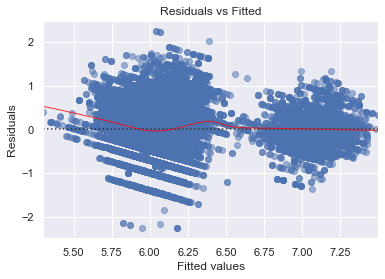

In [92]:
plot_lm_1 = plt.figure()
plot_lm_1.axes[0] = sns.residplot(model_fitted_y, dataframe.columns[-1], data=dataframe,
                          lowess=True,
                          scatter_kws={'alpha': 0.5},
                          line_kws={'color': 'red', 'lw': 1, 'alpha': 0.8})

plot_lm_1.axes[0].set_title('Residuals vs Fitted')
plot_lm_1.axes[0].set_xlabel('Fitted values')
plot_lm_1.axes[0].set_ylabel('Residuals');

The red line is not completely horizontal. This is an indicator that we are failing to capture some of the non-linear features of the model.

**Normal Q-Q Plot**

This plot shows if the residuals are normally distributed. A good normal QQ plot has all of the residuals lying on or close to the red line.

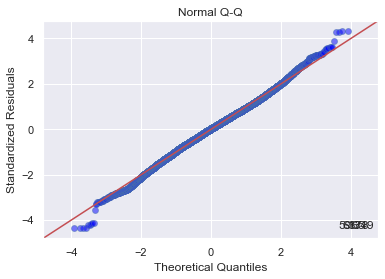

In [93]:
QQ = ProbPlot(model_norm_residuals)
plot_lm_2 = QQ.qqplot(line='45', alpha=0.5, color='#4C72B0', lw=1)
plot_lm_2.axes[0].set_title('Normal Q-Q')
plot_lm_2.axes[0].set_xlabel('Theoretical Quantiles')
plot_lm_2.axes[0].set_ylabel('Standardized Residuals');
# annotations
abs_norm_resid = np.flip(np.argsort(np.abs(model_norm_residuals)), 0)
abs_norm_resid_top_3 = abs_norm_resid[:3]
for r, i in enumerate(abs_norm_resid_top_3):
    plot_lm_2.axes[0].annotate(i,
                               xy=(np.flip(QQ.theoretical_quantiles, 0)[r],
                                   model_norm_residuals[i]));

Most of the data points lie on the red line but few points fall far away from the red line. This is indicative of the errors not being normally distributed, in fact our model suffers from “heavy tails”. We are more likely to see extreme values than to be expected if the data was truly normally distributed.

**Scale-Location**

This plot is a way to check if the residuals suffer from non-constant variance, aka heteroscedasticity. The more horizontal the red line is, the more likely the data is homoscedastic. 

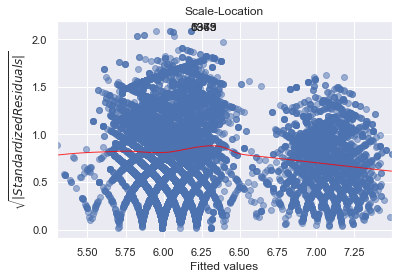

In [94]:
plot_lm_3 = plt.figure()
plt.scatter(model_fitted_y, model_norm_residuals_abs_sqrt, alpha=0.5);
sns.regplot(model_fitted_y, model_norm_residuals_abs_sqrt,
              scatter=False,
              ci=False,
              lowess=True,
              line_kws={'color': 'red', 'lw': 1, 'alpha': 0.8});
plot_lm_3.axes[0].set_title('Scale-Location')
plot_lm_3.axes[0].set_xlabel('Fitted values')
plot_lm_3.axes[0].set_ylabel('$\sqrt{|Standardized Residuals|}$');

# annotations
abs_sq_norm_resid = np.flip(np.argsort(model_norm_residuals_abs_sqrt), 0)
abs_sq_norm_resid_top_3 = abs_sq_norm_resid[:3]
for i in abs_norm_resid_top_3:
    plot_lm_3.axes[0].annotate(i,
                                 xy=(model_fitted_y[i],
                                     model_norm_residuals_abs_sqrt[i]));


Looking at the plot, we can observe that the residuals have an inward opening funnel pattern. The inward opening funnel indicates that the variance is not constant but it is decreasing function of the response variable.

To confirm the presence of heteroscedasticity we use a statistical test called Breusch Pagan Test

**Breusch Pagan Test for heteroscedasticity**

Breush-Pagan test measures how errors increase across the explanatory variable, Y. The test assumes the error variances are due to a linear function of one or more explanatory variables in the model.

H0: The error terms have a constant variance.

H1: The error terms have non constant variance.

In [95]:
import statsmodels.stats.api as sms
name = ['Lagrange multiplier statistic', 'p-value',
        'f-value', 'f p-value']
test = sms.het_breuschpagan(model_fit.resid, model_fit.model.exog)
result = zip(name, test)
result = list(result)
print(result)

[('Lagrange multiplier statistic', 1289.7731943560545), ('p-value', 7.906690496691035e-265), ('f-value', 85.35021035801336), ('f p-value', 8.471705813961379e-273)]


Heteroskedasticity is indicated if p < 0.05, so according to these tests, this model is heteroskedastic. Hence, we reject the null hypothesis. Therefore, The error terms have non constant variance.

**Residuals vs Leverage plot**

Unlike outliers, which have an unusually large y value, leverage points have extreme x values. This may not seem so bad at face value, but it can have damaging effects on the model because the β coefficients are very sensitive to leverage points. The purpose of the Residuals vs Leverage plot is to identify these problematic observations.

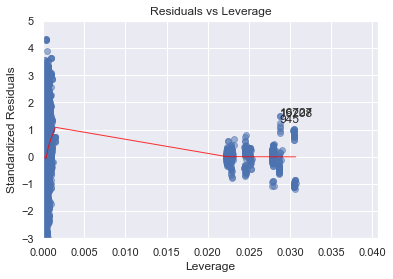

In [96]:
plot_lm_4 = plt.figure();
plt.scatter(model_leverage, model_norm_residuals, alpha=0.5);
sns.regplot(model_leverage, model_norm_residuals,
              scatter=False,
              ci=False,
              lowess=True,
              line_kws={'color': 'red', 'lw': 1, 'alpha': 0.8});
plot_lm_4.axes[0].set_xlim(0, max(model_leverage)+0.01)
plot_lm_4.axes[0].set_ylim(-3, 5)
plot_lm_4.axes[0].set_title('Residuals vs Leverage')
plot_lm_4.axes[0].set_xlabel('Leverage')
plot_lm_4.axes[0].set_ylabel('Standardized Residuals');

# annotations
leverage_top_3 = np.flip(np.argsort(model_cooks), 0)[:3]
for i in leverage_top_3:
    plot_lm_4.axes[0].annotate(i,
                                 xy=(model_leverage[i],
                                     model_norm_residuals[i]));


We can observe the presence of few leverage points. We will try to find out these points using Cook's Distance.

**Cook’s Distance**

Cook’s Distance is a measure of an observation or instances’ influence on a linear regression. Instances with a large influence may be outliers, and datasets with a large number of highly influential points might not be suitable for linear regression without further processing such as outlier removal or imputation.

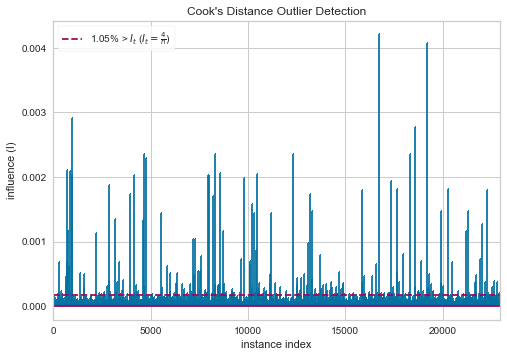

<AxesSubplot:title={'center':"Cook's Distance Outlier Detection"}, xlabel='instance index', ylabel='influence (I)'>

In [97]:
from yellowbrick.regressor import CooksDistance

# Instantiate and fit the visualizer
visualizer = CooksDistance()
visualizer.fit(X, y)
visualizer.show()

The presence of so many highly influential points suggests that linear regression may not be suitable for this dataset.

**Variance Inflation Factor (VIF)**

The condion number addresed the problem of strong multicollinearity but failed to indicate which variable is causing this problem. To understand this we use the method of Variance Inflation Factor. VIF is a measure of the amount of multicollinearity in a set of multiple regression variables. It is the ratio of the overall model variance to the variance of a model that includes only that single independent variable.

In [98]:
#Checking for multicollinearity using VIF

from statsmodels.stats.outliers_influence import variance_inflation_factor as VIF

for i in range(len(dataframe.columns[:-1])):
    v = VIF(np.matrix(dataframe[:-1]),i)
    print("Variance Inflation factor for {}: {}".format(dataframe.columns[i],round(v,2)))

Variance Inflation factor for Online: 3.1
Variance Inflation factor for Booking: 1.3
Variance Inflation factor for Location: 2.96
Variance Inflation factor for Cuisines: 4.11
Variance Inflation factor for Restaurant_Type: 7.26
Variance Inflation factor for Rating: 68.26
Variance Inflation factor for Restaurant_Name_Just Bake: 1.01
Variance Inflation factor for Restaurant_Name_Onesta: 1.02
Variance Inflation factor for Restaurant_Name_Cafe Coffee Day: 1.01
Variance Inflation factor for Restaurant_Name_Five Star Chicken: 1.0
Variance Inflation factor for Restaurant_Name_Baskin Robbins: 1.0
Variance Inflation factor for Restaurant_Name_Kanti Sweets: 1.0
Variance Inflation factor for Restaurant_Name_McDonald's: 1.0
Variance Inflation factor for Restaurant_Name_Empire Restaurant: 1.0
Variance Inflation factor for Restaurant_Name_Domino's Pizza: 1.01
Variance Inflation factor for Restaurant_Name_Smally's Resto Cafe: 1.0


The value of VIF for Rating > 10 which indicates occurance of multicollinearity due to this variable.

There are various techniques to deal with the problem of multicollinearity. In our study we would use two methods data scaling and dropping the variable which is causing multicollinearity. Finally, we would compare the results of both to get the optimal model. 

### 5.2 Checking & Resolving Multicolinearity

In [99]:
import matplotlib.pyplot as plt
import seaborn as sns
import missingno
plt.style.use('ggplot')


In [100]:
df1 = pd.concat([X,y],axis= 1)
df1.head()

,Online,Booking,Location,Cuisines,Restaurant_Type,Rating,Restaurant_Name_Just Bake,Restaurant_Name_Onesta,Restaurant_Name_Cafe Coffee Day,Restaurant_Name_Five Star Chicken,Restaurant_Name_Baskin Robbins,Restaurant_Name_Kanti Sweets,Restaurant_Name_McDonald's,Restaurant_Name_Empire Restaurant,Restaurant_Name_Domino's Pizza,Restaurant_Name_Smally's Resto Cafe,Price
,,,,,,,,,,,,,,,,,
0,1,0,8,449,1,3.8,0,0,0,0,0,0,0,0,0,0,6.476972
1,1,0,22,371,2,3.5,0,0,0,0,0,0,0,0,0,0,5.991465
2,0,1,19,1501,4,4.1,0,0,0,0,0,0,0,0,0,0,8.006368
3,1,0,3,2080,2,3.8,0,0,0,0,0,0,0,0,0,0,5.703782
4,1,0,0,654,2,3.6,0,0,0,0,0,0,0,0,0,0,5.991465


<AxesSubplot:>

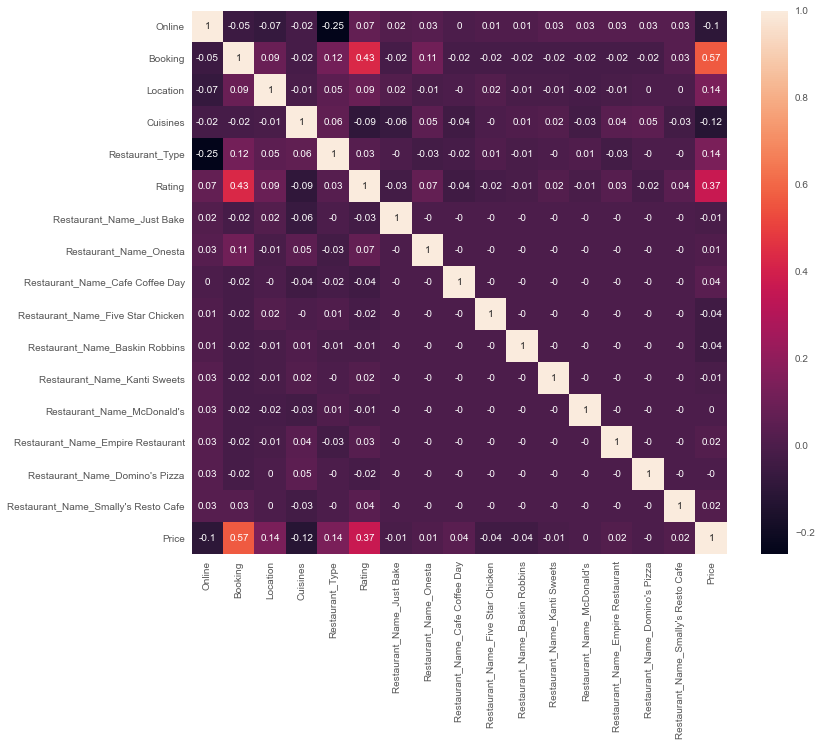

In [101]:
plt.figure(figsize=(12,10))
sns.heatmap(np.round(df1.corr(),2), annot= True)

#### Method 1: Removing the 'Rating' column

In [102]:
x = X.drop(columns= ['Rating'])
x.head()

,Online,Booking,Location,Cuisines,Restaurant_Type,Restaurant_Name_Just Bake,Restaurant_Name_Onesta,Restaurant_Name_Cafe Coffee Day,Restaurant_Name_Five Star Chicken,Restaurant_Name_Baskin Robbins,Restaurant_Name_Kanti Sweets,Restaurant_Name_McDonald's,Restaurant_Name_Empire Restaurant,Restaurant_Name_Domino's Pizza,Restaurant_Name_Smally's Resto Cafe
,,,,,,,,,,,,,,,
0,1,0,8,449,1,0,0,0,0,0,0,0,0,0,0
1,1,0,22,371,2,0,0,0,0,0,0,0,0,0,0
2,0,1,19,1501,4,0,0,0,0,0,0,0,0,0,0
3,1,0,3,2080,2,0,0,0,0,0,0,0,0,0,0
4,1,0,0,654,2,0,0,0,0,0,0,0,0,0,0


In [103]:
# Train Test Split
x_train, x_test, Y_train, Y_test = train_test_split(x, y, test_size=0.20, random_state= 100)

In [104]:
# Fitting the Training Model and obtaining the summary of Test Model.
model=LinearRegression()
model.fit(x_train,Y_train)      

OLS(Y_test,x_test).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                  Price   R-squared (uncentered):                   0.933
Model:                            OLS   Adj. R-squared (uncentered):              0.933
Method:                 Least Squares   F-statistic:                              4260.
Date:                Tue, 27 Apr 2021   Prob (F-statistic):                        0.00
Time:                        20:03:23   Log-Likelihood:                         -8679.4
No. Observations:                4588   AIC:                                  1.739e+04
Df Residuals:                    4573   BIC:                                  1.749e+04
Df Model:                          15                                                  
Covariance Type:            nonrobust                                                  
=======================================================================================================
                                          coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
Online                                  1.7017      0.044     38.702      0.000       1.616       1.788
Booking                                 1.1509      0.068     16.971      0.000       1.018       1.284
Location                                0.0242      0.001     27.724      0.000       0.023       0.026
Cuisines                                0.0009   3.48e-05     26.458      0.000       0.001       0.001
Restaurant_Type                         0.9304      0.016     59.090      0.000       0.900       0.961
Restaurant_Name_Just Bake               0.9491      0.510      1.861      0.063      -0.051       1.949
Restaurant_Name_Onesta                 -0.7566      0.573     -1.320      0.187      -1.880       0.367
Restaurant_Name_Cafe Coffee Day         2.3602      0.485      4.864      0.000       1.409       3.312
Restaurant_Name_Five Star Chicken      -0.8780      0.447     -1.965      0.050      -1.754      -0.002
Restaurant_Name_Baskin Robbins         -0.0392      0.509     -0.077      0.939      -1.037       0.959
Restaurant_Name_Kanti Sweets           -0.5740      0.537     -1.069      0.285      -1.626       0.478
Restaurant_Name_McDonald's             -0.0976      0.609     -0.160      0.873      -1.291       1.095
Restaurant_Name_Empire Restaurant       1.9699      0.929      2.120      0.034       0.148       3.792
Restaurant_Name_Domino's Pizza         -1.0445      0.510     -2.049      0.041      -2.044      -0.045
Restaurant_Name_Smally's Resto Cafe     1.7669      0.720      2.456      0.014       0.356       3.177
==============================================================================
Omnibus:                       46.503   Durbin-Watson:                   1.925
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               49.687
Skew:                           0.218   Prob(JB):                     1.62e-11
Kurtosis:                       3.264   Cond. No.                     5.03e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 5.03e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

#### Method 2: Scaling the 'Rating' column

In [105]:
Rate = X[['Rating']]
x = X.drop(columns= ['Rating'])

In [106]:
from sklearn.preprocessing import StandardScaler

# Standardizing
scaler=StandardScaler()
rate = scaler.fit_transform(Rate)

rate = pd.DataFrame(rate, columns = ['Rating'])
x = pd.concat([x,rate],axis= 1)
x.head()

,Online,Booking,Location,Cuisines,Restaurant_Type,Restaurant_Name_Just Bake,Restaurant_Name_Onesta,Restaurant_Name_Cafe Coffee Day,Restaurant_Name_Five Star Chicken,Restaurant_Name_Baskin Robbins,Restaurant_Name_Kanti Sweets,Restaurant_Name_McDonald's,Restaurant_Name_Empire Restaurant,Restaurant_Name_Domino's Pizza,Restaurant_Name_Smally's Resto Cafe,Rating
0,1,0,8,449,1,0,0,0,0,0,0,0,0,0,0,0.223501
1,1,0,22,371,2,0,0,0,0,0,0,0,0,0,0,-0.459418
2,0,1,19,1501,4,0,0,0,0,0,0,0,0,0,0,0.906420
3,1,0,3,2080,2,0,0,0,0,0,0,0,0,0,0,0.223501
4,1,0,0,654,2,0,0,0,0,0,0,0,0,0,0,-0.231778


In [107]:
# Train Test Split
x_train, x_test, Y_train, Y_test = train_test_split(x, y, test_size=0.20, random_state= 100)

In [108]:
# Fitting the Training Model and obtaining the summary of Test Model.
model=LinearRegression()
model.fit(x_train,Y_train)      

OLS(Y_test,x_test).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                  Price   R-squared (uncentered):                   0.933
Model:                            OLS   Adj. R-squared (uncentered):              0.933
Method:                 Least Squares   F-statistic:                              3993.
Date:                Tue, 27 Apr 2021   Prob (F-statistic):                        0.00
Time:                        20:03:24   Log-Likelihood:                         -8679.4
No. Observations:                4588   AIC:                                  1.739e+04
Df Residuals:                    4572   BIC:                                  1.749e+04
Df Model:                          16                                                  
Covariance Type:            nonrobust                                                  
=======================================================================================================
                                          coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
Online                                  1.7015      0.044     38.608      0.000       1.615       1.788
Booking                                 1.1486      0.074     15.546      0.000       1.004       1.293
Location                                0.0242      0.001     27.668      0.000       0.022       0.026
Cuisines                                0.0009   3.51e-05     26.259      0.000       0.001       0.001
Restaurant_Type                         0.9305      0.016     58.962      0.000       0.900       0.961
Restaurant_Name_Just Bake               0.9514      0.511      1.862      0.063      -0.050       1.953
Restaurant_Name_Onesta                 -0.7579      0.574     -1.322      0.186      -1.882       0.366
Restaurant_Name_Cafe Coffee Day         2.3622      0.486      4.861      0.000       1.409       3.315
Restaurant_Name_Five Star Chicken      -0.8772      0.447     -1.962      0.050      -1.754      -0.001
Restaurant_Name_Baskin Robbins         -0.0384      0.509     -0.075      0.940      -1.037       0.960
Restaurant_Name_Kanti Sweets           -0.5752      0.537     -1.071      0.284      -1.628       0.478
Restaurant_Name_McDonald's             -0.0982      0.609     -0.161      0.872      -1.291       1.095
Restaurant_Name_Empire Restaurant       1.9677      0.930      2.116      0.034       0.145       3.791
Restaurant_Name_Domino's Pizza         -1.0456      0.510     -2.050      0.040      -2.046      -0.046
Restaurant_Name_Smally's Resto Cafe     1.7650      0.720      2.452      0.014       0.354       3.177
Rating                                  0.0021      0.026      0.080      0.937      -0.050       0.054
==============================================================================
Omnibus:                       46.420   Durbin-Watson:                   1.925
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               49.586
Skew:                           0.218   Prob(JB):                     1.71e-11
Kurtosis:                       3.264   Cond. No.                     5.03e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 5.03e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

After using both the techniques, we can observe that the multicollinearity problem still persists.

Therefore, three of the assumptions of linear regression 

- The error terms must follow normal distribution.

- The error terms must have a constant variance.

- There is no correlation between independent variables.

are violated. Hence, multiple linear regression may not be suitable for this dataset. 

We will be using much more effient models which are immune to multicollinearity in the later sections to get a optimal model.

## 6. Feature Selection

Feature selection is the process of reducing the number of input variables when developing a predictive model. There are three reasons why we don’t select all the variables for our analysis, they are:

- Curse of dimensionality:If we have more columns in the data than the number of rows, we will be able to fit our training data perfectly, but that won’t generalize to the new samples. And thus we learn absolutely nothing.

- Occam’s Razor:We want our models to be simple and explainable. We lose explainability when we have a lot of features.

- Garbage In Garbage out:Most of the times, we will have many non-informative features. For example, in our case url was one such variable.Poor-quality input will produce Poor-Quality output.

### 6.1 Feature Selection Using Filter Method

In this method, we filter and take only the subset of the relevant features. The model is built after selecting the features. 


#### 6.1.1 Correlaton Matrix

The filtering here is done using correlation matrix and it is most commonly done using Pearson correlation. Correlation is a statistical association which refers to the degree to which a pair of variables are linearly related.

In [109]:
data = pd.concat([X,y],axis= 1)
data.head()

,Online,Booking,Location,Cuisines,Restaurant_Type,Rating,Restaurant_Name_Just Bake,Restaurant_Name_Onesta,Restaurant_Name_Cafe Coffee Day,Restaurant_Name_Five Star Chicken,Restaurant_Name_Baskin Robbins,Restaurant_Name_Kanti Sweets,Restaurant_Name_McDonald's,Restaurant_Name_Empire Restaurant,Restaurant_Name_Domino's Pizza,Restaurant_Name_Smally's Resto Cafe,Price
,,,,,,,,,,,,,,,,,
0,1,0,8,449,1,3.8,0,0,0,0,0,0,0,0,0,0,6.476972
1,1,0,22,371,2,3.5,0,0,0,0,0,0,0,0,0,0,5.991465
2,0,1,19,1501,4,4.1,0,0,0,0,0,0,0,0,0,0,8.006368
3,1,0,3,2080,2,3.8,0,0,0,0,0,0,0,0,0,0,5.703782
4,1,0,0,654,2,3.6,0,0,0,0,0,0,0,0,0,0,5.991465


<AxesSubplot:>

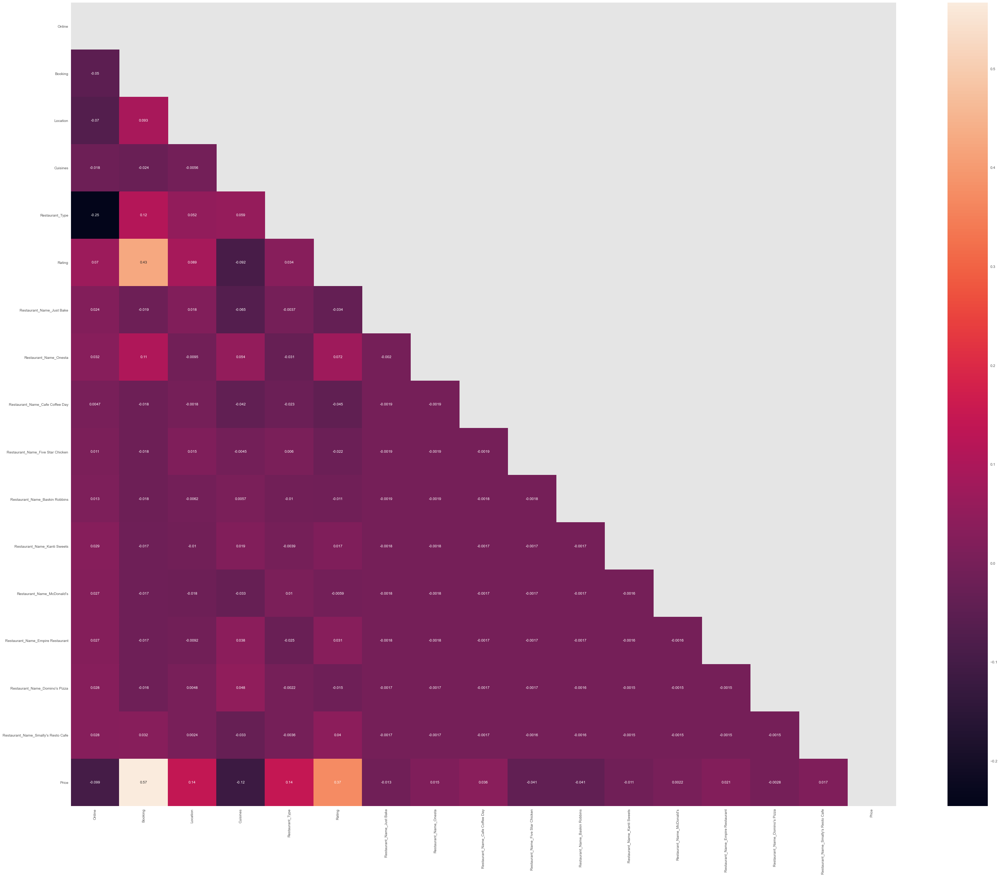

In [110]:
#Compute the correlation matrix
corr = data.corr()

# Generate a mask for the upper triangle
matrix = np.triu(corr)

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(50,40))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, annot=True, mask=matrix)

The plot depicts the correlation between the variables and also the correlation with the target variable. The shades of purple depicts degree of negative correlation and the shades of peach depicts degree of positive correlation.

In [111]:
# Correlation with output variable
cor_target = abs(corr["Price"])

# Selecting highly correlated features
relevant_features = cor_target[cor_target>0.5]
relevant_features

Booking    0.566973
Price      1.000000
Name: Price, dtype: float64

- We can observe that only 1 variable is highly correlated with the target variable. Now, we will check for moderate correlation.

In [112]:
relevant_features = cor_target[cor_target > 0.1]
relevant_features

Booking            0.566973
Location           0.142363
Cuisines           0.118582
Restaurant_Type    0.144902
Rating             0.370775
Price              1.000000
Name: Price, dtype: float64

- There are 5 variables which are moderately correlated with Price. As part of exploration we will try some more efficient methods for feature selection.

#### 6.1.2 Mutual Information

Mutual Information between two variables measures the dependence of one variable to another. 

- If X and Y are two variables, and if X and Y are independent, then no information about Y can be obtained by knowing X or vice versa. Hence their mutual information is 0.

- If X is a deterministic function of Y, then we can determine X from Y and Y from X with mutual information 1.

- When we have Y = f(X,Z,M,N), 0 < mutual information < 1

We can select our features from feature space by ranking their mutual information with the target variable.

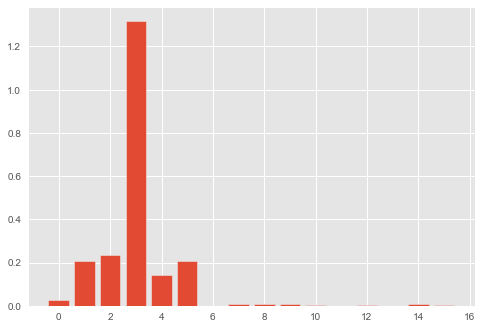

In [113]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import mutual_info_regression

def select_features(X_train, y_train, X_test):
    # configure to select all features
    fs = SelectKBest(score_func= mutual_info_regression, k= 'all')
    # learn relationship from training data
    fs.fit(X_train, y_train)
    # transform train input data
    X_train_fs = fs.transform(X_train)
    # transform test input data
    X_test_fs = fs.transform(X_test)
    return X_train_fs, X_test_fs, fs

# feature selection
X_train_fs, X_test_fs, fs = select_features(X_train, y_train, X_test)

# plot the scores
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.show()

In [114]:
# what are scores for the features
for i in range(len(fs.scores_)):
    print('Feature %d: %f' % (i, fs.scores_[i]))

Feature 0: 0.025095
Feature 1: 0.205122
Feature 2: 0.234381
Feature 3: 1.317367
Feature 4: 0.143511
Feature 5: 0.205314
Feature 6: 0.000181
Feature 7: 0.007999
Feature 8: 0.006858
Feature 9: 0.007998
Feature 10: 0.002066
Feature 11: 0.000000
Feature 12: 0.005411
Feature 13: 0.000000
Feature 14: 0.007628
Feature 15: 0.001451


This method suggests the following features are important

- Feature 1 : Booking

- Feature 2 : Location
    
- Feature 3 : Cuisines
    
- Feature 4 : Restaurant_Type
    
- Feature 5 : Rating

These features were suggested by the correlation method as well.

### 6.2 Feature Selection Using Wrapper Method

A wrapper method needs one machine learning algorithm and uses its performance as evaluation criteria. This means, we feed the features to the selected Machine Learning algorithm and based on the model performance we add/remove the features. This is an iterative and computationally expensive process but it is more accurate than the filter method.

There are different wrapper methods such as Backward Elimination, Forward Selection, Bidirectional Elimination and RFE. In our study we will use the Recursive Feature Elimination Method (RFE).  

#### 6.2.1 Recursive Feature Elimination Method (RFE)

The Recursive Feature Elimination (RFE) method works by recursively removing attributes and building a model on those attributes that remain. It uses accuracy metric to rank the feature according to their importance. The RFE method takes the model to be used and the number of required features as input. It then gives the ranking of all the variables, 1 being most important. It also gives its support, True being relevant feature and False being irrelevant feature.

In [115]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.feature_selection import RFE

model = RandomForestRegressor()

#Initializing RFE model
rfe = RFE(model, 17)

#Transforming data using RFE
X_rfe = rfe.fit_transform(X,y)

#Fitting the data to model
model.fit(X_rfe,y)

#Printing the results
print(rfe.support_)
print(rfe.ranking_)

[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True]
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


Now we need to find the optimum number of features, for which the accuracy is the highest. We do that by using loop starting with 1 feature and going up to 17. We then take the one for which the accuracy is highest.

In [116]:
#no of features
nof_list=np.arange(1,17)            
high_score=0

#Variable to store the optimum features
nof=0           
score_list =[]
for n in range(len(nof_list)):
    X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.3, random_state = 0)
    model = RandomForestRegressor()
    rfe = RFE(model,nof_list[n])
    X_train_rfe = rfe.fit_transform(X_train,y_train)
    X_test_rfe = rfe.transform(X_test)
    model.fit(X_train_rfe,y_train)
    score = model.score(X_test_rfe,y_test)
    score_list.append(score)
    if(score>high_score):
        high_score = score
        nof = nof_list[n]

#Printing the result
print("Optimum number of features: %d" %nof)
print("Score with %d features: %f" % (nof, high_score))

Optimum number of features: 4
Score with 4 features: 0.860507


- The optimum number of features is 4. We now feed as number of features to RFE and get the final set of features given by RFE method.

In [117]:
cols = list(X.columns)
model = RandomForestRegressor()

#Initializing RFE model
rfe = RFE(model, 4)   

#Transforming data using RFE
X_rfe = rfe.fit_transform(X,y)  

#Fitting the data to model
model.fit(X_rfe,y)              
temp = pd.Series(rfe.support_,index = cols)
selected_features_rfe = temp[temp==True].index

#Printing the result
print(selected_features_rfe)

Index(['Booking', 'Location', 'Cuisines', 'Rating'], dtype='object')


This method suggests that four features, Booking, Location, Cuisines, and Rating are important for our analysis. All the four variables were also suggested by the correlation and mutual information method.

### 6.3 Feature Selection Using Embedded Method

Embedded methods are iterative in a sense that takes care of each iteration of the model training process and carefully extract those features which contribute the most to the training for a particular iteration. Regularization methods are the most commonly used embedded methods which penalize a feature given a coefficient threshold.

#### 6.3.1 Lasso regularization

Here we will do feature selection using Lasso regularization. If the feature is irrelevant, lasso penalizes it’s coefficient and make it 0. Hence the features with coefficient = 0 are removed and the rest are taken.

In [118]:
from sklearn.linear_model import LassoCV

reg = LassoCV()
reg.fit(X, y)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(X,y))
coef = pd.Series(reg.coef_, index = X.columns)

Best alpha using built-in LassoCV: 0.048960
Best score using built-in LassoCV: 0.310552


In [119]:
print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")

Lasso picked 5 variables and eliminated the other 11 variables


In [120]:
features = pd.Series(coef != 0,index = cols)
selected_features_rfe = features[features==True].index

print("The selected variables are :", selected_features_rfe)

The selected variables are : Index(['Booking', 'Location', 'Cuisines', 'Restaurant_Type', 'Rating'], dtype='object')


Text(0.5, 1.0, 'Feature importance using Lasso Model')

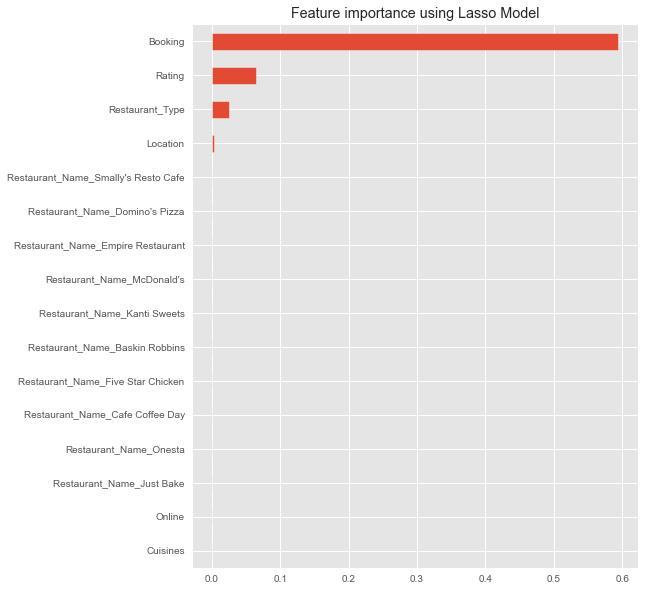

In [121]:
imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (8.0, 10.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

This method suggests that five features, Booking, Location, Cuisines, Restaurant_Type, and Rating are important for our analysis. All the five variables were suggested by the correlation and mutual information method and out of these 5, 4 were suggested by RFE as well.

#### 6.3.2 Feature Importance 

Feature importance shows how much each feature contributed to the model.

We could take this information and remove features which don't contribute much to reduce dimenstionality (and save compute).

Feature importance figures also show people who may not be familiar with the problem what features of their data are most important when it comes to making predictions with machine learning models.

In [122]:
from sklearn.ensemble import ExtraTreesRegressor

model = ExtraTreesRegressor()
model.fit(X,y)

print(model.feature_importances_)

[2.85890564e-02 3.25414578e-01 1.62231705e-01 2.82295159e-01
 7.88181442e-02 1.15516669e-01 1.94138999e-04 1.45519209e-03
 2.32193569e-03 6.63476923e-04 4.17622229e-04 6.43028612e-04
 2.03318042e-04 5.40443765e-04 3.15351616e-04 3.80181112e-04]


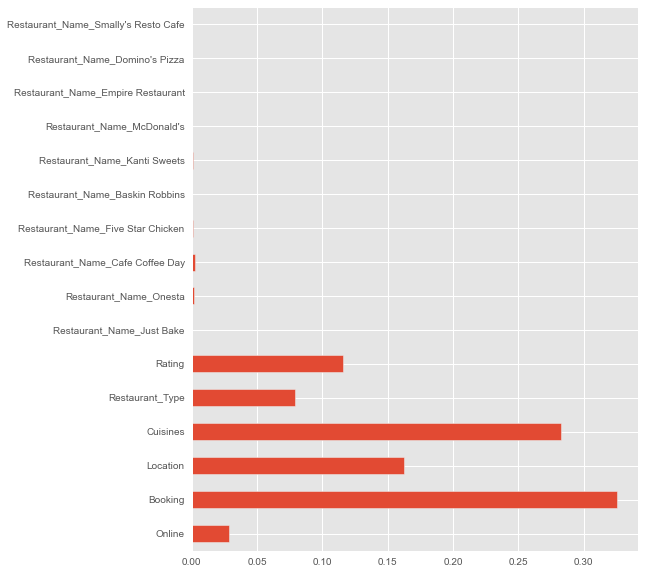

In [123]:
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.plot(kind= 'barh')
plt.show()

This method suggests that six features, Online, Booking, Location, Cuisines, Restaurant_Type, and Rating are important for our analysis. Out of these 6 variables 5 were suggested by the correlation, mutual information and LassoCV methods and 4 were suggested by RFE method.

In [125]:
# Creating Dataframe of important Features.
X = X[['Online','Booking','Location','Cuisines','Restaurant_Type','Rating']]
X.head()

,Online,Booking,Location,Cuisines,Restaurant_Type,Rating
,,,,,,
0,1,0,8,449,1,3.8
1,1,0,22,371,2,3.5
2,0,1,19,1501,4,4.1
3,1,0,3,2080,2,3.8
4,1,0,0,654,2,3.6


In [128]:
# Viewing the Target values.
y.head()


0    6.476972
1    5.991465
2    8.006368
3    5.703782
4    5.991465
Name: Price, dtype: float64

In [200]:
final = pd.concat([X,y],axis= 1)
final.head()

,Online,Booking,Location,Cuisines,Restaurant_Type,Rating,Price
,,,,,,,
0,1,0,8,449,1,3.8,6.476972
1,1,0,22,371,2,3.5,5.991465
2,0,1,19,1501,4,4.1,8.006368
3,1,0,3,2080,2,3.8,5.703782
4,1,0,0,654,2,3.6,5.991465


In [201]:
final.to_csv('model_data.csv',index= False)